## 1. Problem staterment
1. predict which customer is more likely to purchase the newly introduced travel package.
2. Make recommendations to the Policy Maker and Marketing Team to target the potential customer who is going to purchase the newly introduced travel package.

### Import libraries

In [160]:
import warnings
warnings.filterwarnings("ignore")

# Libraries to help with reading and manipulating data
import pandas as pd
import numpy as np

from sklearn.preprocessing import RobustScaler

# Library to split data
from sklearn.model_selection import train_test_split

# Libraries to help with model building
from sklearn.linear_model import LogisticRegression
from sklearn.tree import DecisionTreeClassifier
from sklearn import tree

# Libaries to help with data visualization
import matplotlib.pyplot as plt
import seaborn as sns

# Removes the limit from the number of displayed columns and rows.
pd.set_option("display.max_columns", None)
# pd.set_option('display.max_rows', None)
pd.set_option("display.max_rows", 200)

# for statistical analysis 
import statsmodels.stats.api as sms
from statsmodels.stats.outliers_influence import variance_inflation_factor
from statsmodels.tools.tools import add_constant


# To get diferent metric scores
from sklearn import metrics
from sklearn.metrics import accuracy_score, recall_score, precision_score, roc_auc_score, roc_curve, confusion_matrix, precision_recall_curve, f1_score

from sklearn import tree
from sklearn.model_selection import GridSearchCV
from sklearn.ensemble import BaggingClassifier
from sklearn.ensemble import RandomForestClassifier
from sklearn.model_selection import GridSearchCV

from sklearn.ensemble import AdaBoostClassifier, GradientBoostingClassifier,StackingClassifier
#To install xgboost library use - !pip install xgboost 
from xgboost import XGBClassifier


## 2. Load data

In [2]:
df = pd.read_csv('Tourism.csv')


In [3]:
df.head()

,CustomerID,ProdTaken,Age,TypeofContact,CityTier,DurationOfPitch,Occupation,Gender,NumberOfPersonVisiting,NumberOfFollowups,ProductPitched,PreferredPropertyStar,MaritalStatus,NumberOfTrips,Passport,PitchSatisfactionScore,OwnCar,NumberOfChildrenVisiting,Designation,MonthlyIncome
0,200000,1,41.0,Self Enquiry,3,6.0,Salaried,Female,3,3.0,Deluxe,3.0,Single,1.0,1,2,1,0.0,Manager,20993.0
1,200001,0,49.0,Company Invited,1,14.0,Salaried,Male,3,4.0,Deluxe,4.0,Divorced,2.0,0,3,1,2.0,Manager,20130.0
2,200002,1,37.0,Self Enquiry,1,8.0,Free Lancer,Male,3,4.0,Basic,3.0,Single,7.0,1,3,0,0.0,Executive,17090.0
3,200003,0,33.0,Company Invited,1,9.0,Salaried,Female,2,3.0,Basic,3.0,Divorced,2.0,1,5,1,1.0,Executive,17909.0
4,200004,0,NaN,Self Enquiry,1,8.0,Small Business,Male,2,3.0,Basic,4.0,Divorced,1.0,0,5,1,0.0,Executive,18468.0


## 3.Exploratory Data analysis

### 3.1 shape and data type

In [4]:
print(f'There are {df.shape[0]} rows and {df.shape[1]} columns.')  # f-string

There are 4888 rows and 20 columns.


In [5]:
df.info()

<class 'pandas.core.frame.DataFrame'>
RangeIndex: 4888 entries, 0 to 4887
Data columns (total 20 columns):
 #   Column                    Non-Null Count  Dtype  
---  ------                    --------------  -----  
 0   CustomerID                4888 non-null   int64  
 1   ProdTaken                 4888 non-null   int64  
 2   Age                       4662 non-null   float64
 3   TypeofContact             4863 non-null   object 
 4   CityTier                  4888 non-null   int64  
 5   DurationOfPitch           4637 non-null   float64
 6   Occupation                4888 non-null   object 
 7   Gender                    4888 non-null   object 
 8   NumberOfPersonVisiting    4888 non-null   int64  
 9   NumberOfFollowups         4843 non-null   float64
 10  ProductPitched            4888 non-null   object 
 11  PreferredPropertyStar     4862 non-null   float64
 12  MaritalStatus             4888 non-null   object 
 13  NumberOfTrips             4748 non-null   float64
 14  Passport

#### Insights:

1. There are missing values in columns TypeofContact, DurationOfPitch,NumberOfFollowups, PreferredPropertyStar, NumberOfTrips,NumberOfChildrenVisiting,MonthlyIncome.
2. We can convert the object type columns to categories.

### Fixing the data types

In [6]:
cols = df.select_dtypes(['object'])
cols.columns

Index(['TypeofContact', 'Occupation', 'Gender', 'ProductPitched',
       'MaritalStatus', 'Designation'],
      dtype='object')

In [7]:
for i in cols.columns:
    df[i] = df[i].astype('category')

In [8]:
df.info()

<class 'pandas.core.frame.DataFrame'>
RangeIndex: 4888 entries, 0 to 4887
Data columns (total 20 columns):
 #   Column                    Non-Null Count  Dtype   
---  ------                    --------------  -----   
 0   CustomerID                4888 non-null   int64   
 1   ProdTaken                 4888 non-null   int64   
 2   Age                       4662 non-null   float64 
 3   TypeofContact             4863 non-null   category
 4   CityTier                  4888 non-null   int64   
 5   DurationOfPitch           4637 non-null   float64 
 6   Occupation                4888 non-null   category
 7   Gender                    4888 non-null   category
 8   NumberOfPersonVisiting    4888 non-null   int64   
 9   NumberOfFollowups         4843 non-null   float64 
 10  ProductPitched            4888 non-null   category
 11  PreferredPropertyStar     4862 non-null   float64 
 12  MaritalStatus             4888 non-null   category
 13  NumberOfTrips             4748 non-null   float6

`we can see that the memory usage has decreased from 763.9 KB to 564.4 KB`, this technique is generally useful for bigger datasets.

### 3.2 Basic summary statistics and consequences

#### Central Tendency of data

In [9]:
df.describe().T

,count,mean,std,min,25%,50%,75%,max
CustomerID,4888.0,202443.500000,1411.188388,200000.0,201221.75,202443.5,203665.25,204887.0
ProdTaken,4888.0,0.188216,0.390925,0.0,0.00,0.0,0.00,1.0
Age,4662.0,37.622265,9.316387,18.0,31.00,36.0,44.00,61.0
CityTier,4888.0,1.654255,0.916583,1.0,1.00,1.0,3.00,3.0
DurationOfPitch,4637.0,15.490835,8.519643,5.0,9.00,13.0,20.00,127.0
NumberOfPersonVisiting,4888.0,2.905074,0.724891,1.0,2.00,3.0,3.00,5.0
NumberOfFollowups,4843.0,3.708445,1.002509,1.0,3.00,4.0,4.00,6.0
PreferredPropertyStar,4862.0,3.581037,0.798009,3.0,3.00,3.0,4.00,5.0
NumberOfTrips,4748.0,3.236521,1.849019,1.0,2.00,3.0,4.00,22.0
Passport,4888.0,0.290917,0.454232,0.0,0.00,0.0,1.00,1.0


#### Skewness

In [10]:
df.skew()

CustomerID                  0.000000
ProdTaken                   1.595763
Age                         0.382989
CityTier                    0.736531
DurationOfPitch             1.752037
NumberOfPersonVisiting      0.029817
NumberOfFollowups          -0.372719
PreferredPropertyStar       0.895545
NumberOfTrips               1.453884
Passport                    0.920980
PitchSatisfactionScore     -0.127726
OwnCar                     -0.495892
NumberOfChildrenVisiting    0.272199
MonthlyIncome               1.949160
dtype: float64

#### Insights:

1. `CustomerID`: column can be dropped as it is simple Id.
2. `Age`: minmum age is 18 and maximum age is 61 with mean 37.6 and positively skewed.
3. `ProdTaken`: product taken only have 2 values 0 and 1. it is acategorical variable.
4. `CityTier` : city tier has min 1 and max 3. As per the data disctionary, it is a categorical variable.
5. `DurationOfPitch` : min is 5 and max is 127 with mean value is 15.4. this variable is positively skewed and have outliers.
6. `NumberOfPersonVisiting` : Minimum  is 1  and maximum is 5. This column has positive skewness.
7. `NumberOfFollowups` : Minimum  is 1 and maximum is 6. This column seems negatively skewed.
8. `PreferredPropertyStar` : Minimum  is 3  and maximum is 5. This column has positive skewness. It is categorical variable.
9. `NumberOfTrips` : minimum is 1 and maximum is 22. Also 25% an 50% are 2 and 3 respectively. This column definetely has positive skewness and outliers.
10. `PitchSatisfactionScore`: min is 1 and max is 5.
11. `MonthlyIncome` : min is 1000 and max is 98678.0. it is positively skewed and have outliers.
10. `Passport`,`PitchSatisfactionScore`,`OwnCar`,`ProdTaken`,`cityTier`: all of these variables are categorical.
11. `ProdTaken` : is target variable.

#### Changing data type of Passport,PitchSatisfactionScore,OwnCar,ProdTaken,cityTier to category

In [11]:
#cols = ['Passport','PitchSatisfactionScore','OwnCar','ProdTaken','CityTier','PreferredPropertyStar']
#for i in cols:
#    df[i] = df[i].astype('category')


In [12]:
df.describe(include=['category']).T

,count,unique,top,freq
TypeofContact,4863,2,Self Enquiry,3444
Occupation,4888,4,Salaried,2368
Gender,4888,3,Male,2916
ProductPitched,4888,5,Basic,1842
MaritalStatus,4888,4,Married,2340
Designation,4888,5,Executive,1842


#### Insights

1. `TypeofContact`: Almost 70% customer was contacted by Self Enquiry. It has some missing values.
2. `Occupation`: Majority of customers are Salaried.
3. `Gender`: There are more male customers than female customers
4. `ProductPitched`: Majority of customers got pitch for `Basic`package.
5. `MaritalStatus`: Majority of customers are `Married`.
6. `Designation`: Most frequent designation is `Executive`.


#### Checking caterogies for categorical variables

In [13]:
cols_cat= df.select_dtypes(['category'])

for col in cols_cat:
    value_counts = df[col].value_counts(dropna=False)
    print(value_counts)
    print('\n\n')

Self Enquiry       3444
Company Invited    1419
NaN                  25
Name: TypeofContact, dtype: int64



Salaried          2368
Small Business    2084
Large Business     434
Free Lancer          2
Name: Occupation, dtype: int64



Male       2916
Female     1817
Fe Male     155
Name: Gender, dtype: int64



Basic           1842
Deluxe          1732
Standard         742
Super Deluxe     342
King             230
Name: ProductPitched, dtype: int64



Married      2340
Divorced      950
Single        916
Unmarried     682
Name: MaritalStatus, dtype: int64



Executive         1842
Manager           1732
Senior Manager     742
AVP                342
VP                 230
Name: Designation, dtype: int64





In [14]:
cols = ['Passport','PitchSatisfactionScore','OwnCar','ProdTaken','CityTier','PreferredPropertyStar']
for col in cols:
    value_counts = df[col].value_counts(dropna=False)
    print(value_counts)
    print('\n\n')

0    3466
1    1422
Name: Passport, dtype: int64



3    1478
5     970
1     942
4     912
2     586
Name: PitchSatisfactionScore, dtype: int64



1    3032
0    1856
Name: OwnCar, dtype: int64



0    3968
1     920
Name: ProdTaken, dtype: int64



1    3190
3    1500
2     198
Name: CityTier, dtype: int64



3.0    2993
5.0     956
4.0     913
NaN      26
Name: PreferredPropertyStar, dtype: int64





### 3.3 Preprocessing of Data

In [15]:
###  gender variable contaains 'Fe Male' value which can be converted to Female
df['Gender']=df['Gender'].apply(lambda x: 'Female' if x=='Fe Male' else x)

In [16]:
df['Gender'].value_counts()

Male      2916
Female    1972
Name: Gender, dtype: int64

### 3.4 Univariate and Bivariate Analysis

### 3.4.1  Univariant Plots of continuous variables

In [17]:
##Methods to plot box plot and histgram for  features
def histgram_BoxPlot(feature, figsize=(15,10)):
    f2, (ax_box, ax_hist) = plt.subplots(nrows = 2, # Number of rows of the subplot grid= 2
                  sharex = True, # x-axis will be shared among all subplots
                  gridspec_kw = {"height_ratios": (.25, .75)}, 
                  figsize = figsize 
                 ) # creating the 2 subplots
    sns.distplot(feature,ax=ax_hist, kde= True)
    sns.boxplot(feature, ax=ax_box,showmeans=True, color= 'Green')
    ax_hist.axvline(np.mean(feature), color='g', linestyle='--')# Add mean to the histogram
    ax_hist.axvline(np.median(feature), color='black', linestyle='-') # Add median to the histogram

#### plots for Age

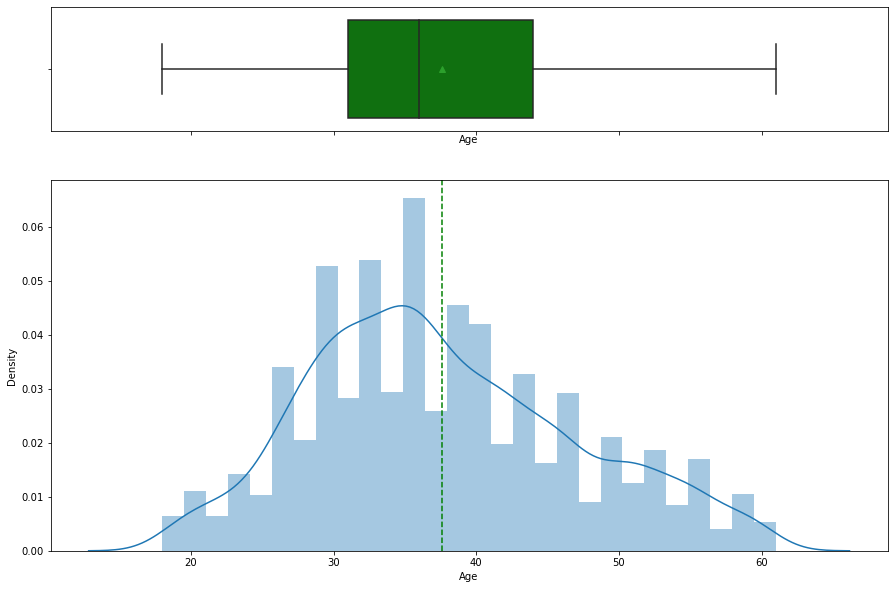

In [18]:
histgram_BoxPlot(df['Age']);

#### Insights:

`Age` : There is no outliers in experience variable but it is positively skewed.

#### Plot for Monthly Income

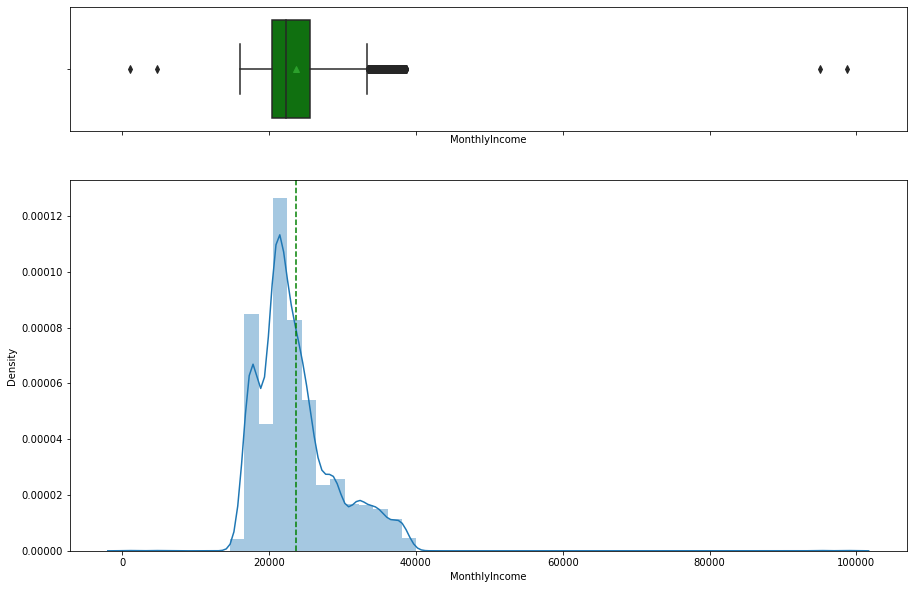

In [19]:

histgram_BoxPlot(df['MonthlyIncome']);

#### Insights:

`MonthlyIncome` : Income variable has outliers and is positively skewed. We need to handle outliers and skewness.


#### Plot for DurationOfPitch

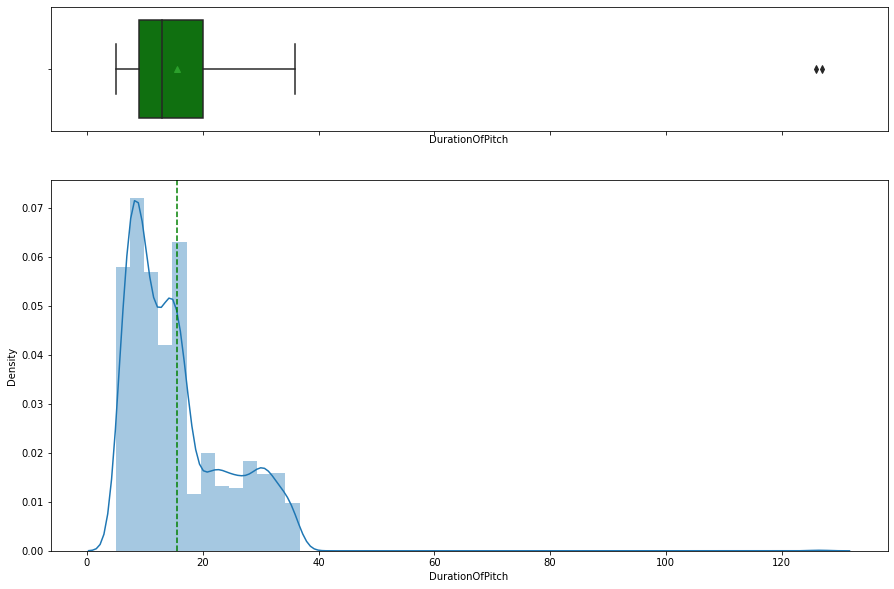

In [20]:
histgram_BoxPlot(df['DurationOfPitch']);

In [21]:
df['DurationOfPitch'].median()

13.0

#### Insights

`DurationOfPitch` : It has outliers and is highly skewness. Median for this variable is 13.


#### Plot for NumberOfPersonVisiting

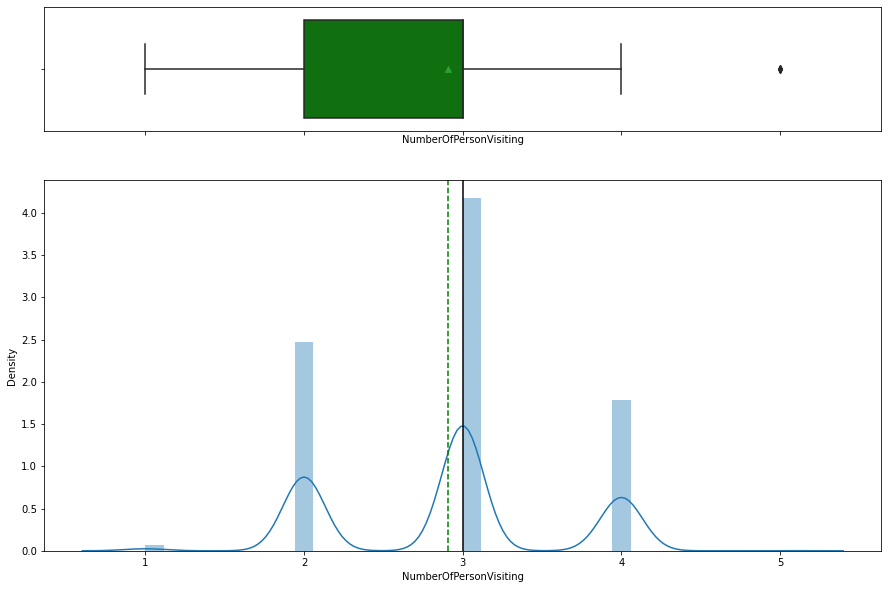

In [22]:
histgram_BoxPlot(df['NumberOfPersonVisiting']);

#### Insights:

`NumberOfPersonVisiting` : NumberOfPersonVisiting variable has outlier at 5 and is also positive skewed. Most frequent value of NumberOfPErsonVisiting is 3.

#### Plot for NumberOfFollowups

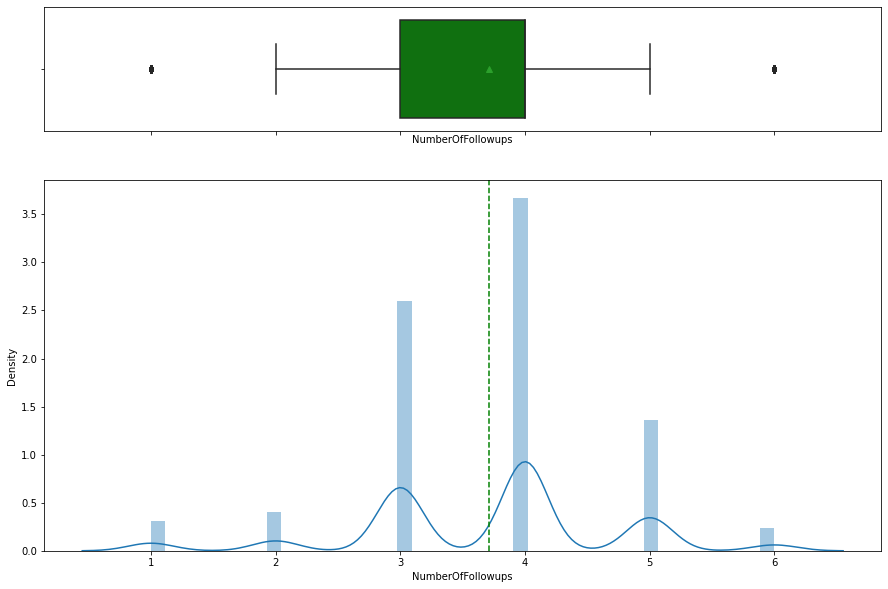

In [23]:
histgram_BoxPlot(df['NumberOfFollowups']);

#### Insights:

`NumberOFFollowUps` : it has outliers and  positive skewness.Most frequent value of numberOfFollowUps is 4. It has outlier at 1 and 6.

#### plot for NumberOfTrips

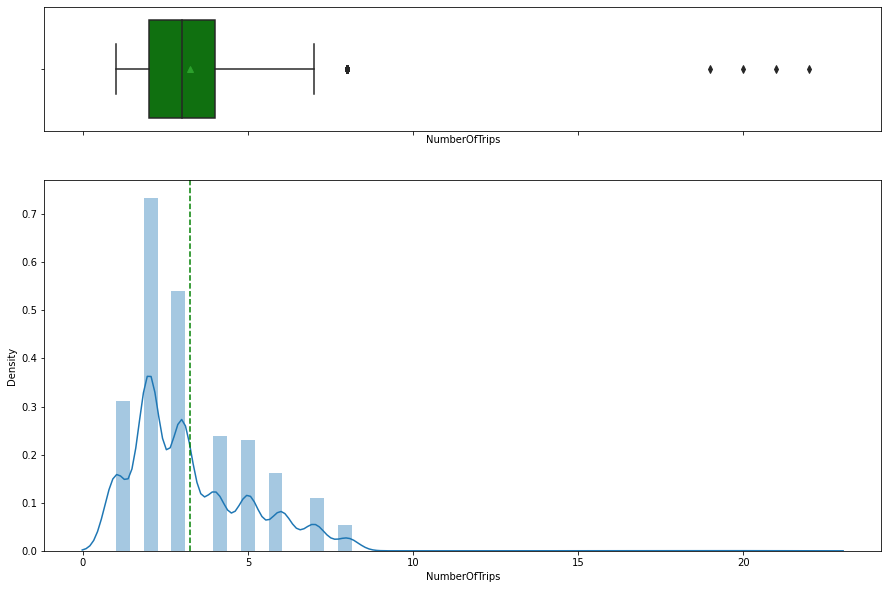

In [24]:
histgram_BoxPlot(df['NumberOfTrips']);

#### Insights:

 `numberOfTrips` : it has outliers and  positive skewness. Most frequent value of numberOfTrips is 2. There are 4 outliers at number of trips 19,20,21,22 .


### 3.4.b Univariant plot for categorical variables

In [25]:
##Method to plot bar plot with percentage for each category of featrure
def barPlot_percentDist(feature):
    total = len(df[feature])# total size of column
    plt.figure(figsize=(10,5))
    plt.xticks(rotation=45)
    ax=sns.countplot(df[feature],palette='Paired')
    for p in ax.patches:
        percentage = '{:.1f}%'.format(100 * p.get_height()/total) # percentage of each class of the category
        x = p.get_x() + p.get_width() / 2 - 0.05 # width of the plot
        y = p.get_y() + p.get_height()           # hieght of the plot
        
        ax.annotate(percentage, (x, y), size = 15) # annotate the percantage 
    plt.show() # show the plot
  

#### Plot for ProdTaken

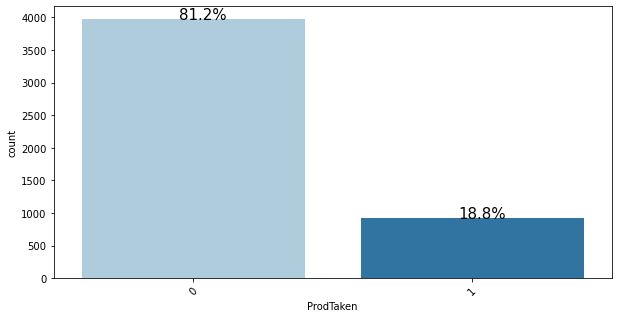

In [26]:
barPlot_percentDist('ProdTaken')

* Majority of customers did not take the product and only 18.8% customer has accepted the product.

#### Plot for TypeofContact	

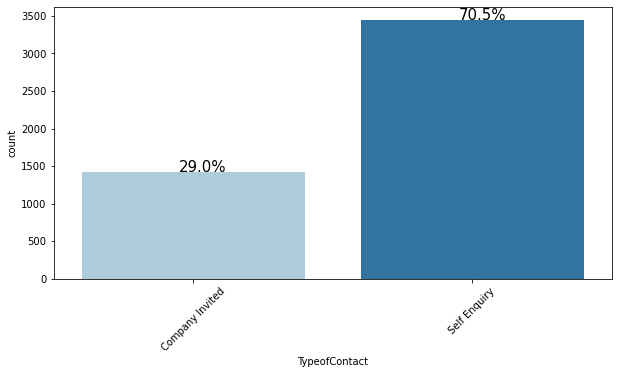

In [27]:
barPlot_percentDist('TypeofContact')

* 70.5% of the customer contacted through self enquiry followed by 29% employee were company invited.

#### Plot for CityTier

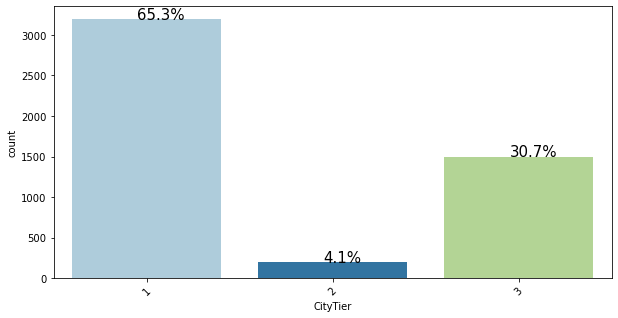

In [28]:
barPlot_percentDist('CityTier')

65.3% of customer are from citytier 1 followed by 30.7% customers from citytier 3.

#### Plot for Occupation

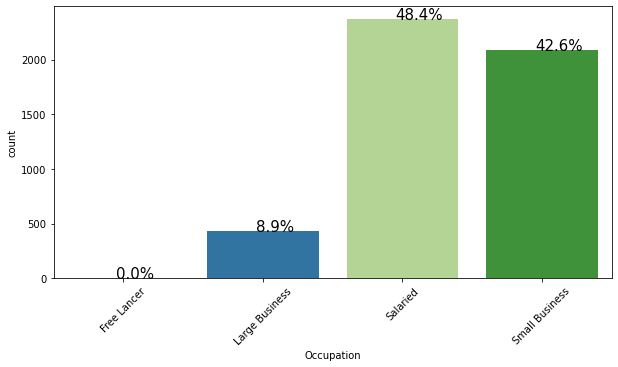

In [29]:
barPlot_percentDist('Occupation')

* 48.4% customers are salaried followed by 42.6% customers have small business.

#### Plot for Gender

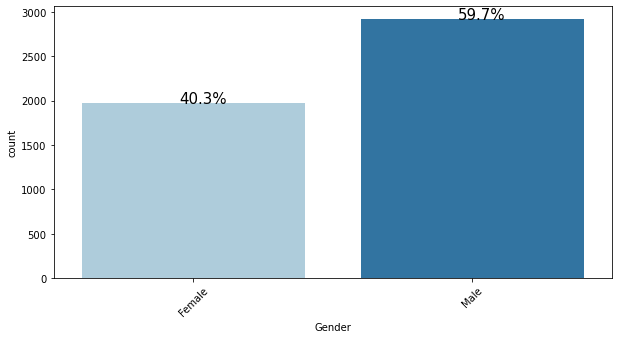

In [30]:
barPlot_percentDist('Gender')

* 59.7%  customers are Male and 40.3% customers are female.

#### Plot for ProductPitched

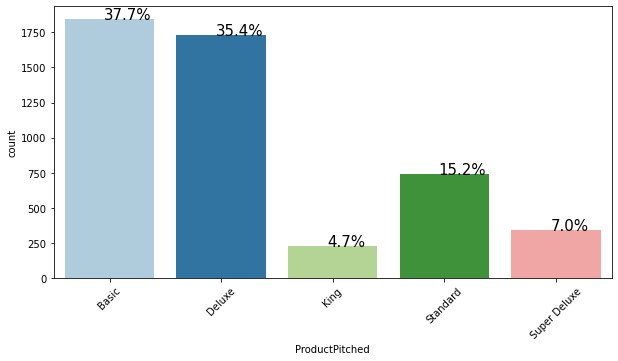

In [31]:
barPlot_percentDist('ProductPitched')

* 37.7% customers got Basic pitch followed by 35.4% got deluxe pitch.

#### Plot for MaritalStatus

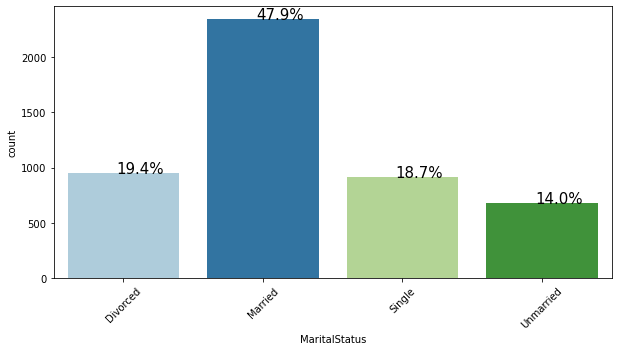

In [32]:
barPlot_percentDist('MaritalStatus')

* 47.9% customers are married followed by 19.4% are divorced and 18.7% are single.

#### Plot for Passport

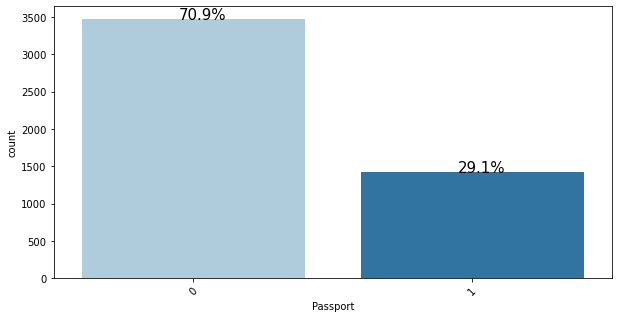

In [33]:
barPlot_percentDist('Passport')

* 70.9% customers do not have passport.

#### plot for PitchSatisfactionScore

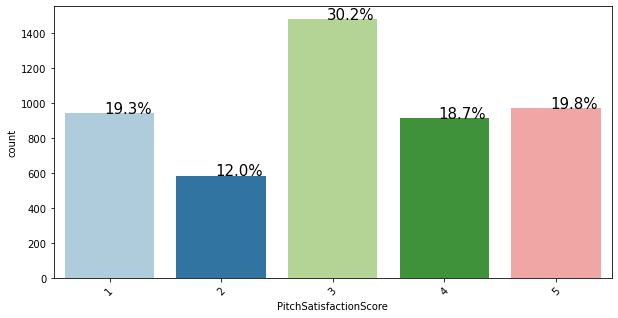

In [34]:
barPlot_percentDist('PitchSatisfactionScore')

* 30.2 %  gave 3 for pitchSatisfactionScore. Only 19.8% gave 5 as pitch satisfaction score. We do not know whether  1 or 5 is the best score.

#### plot for OwnCar	

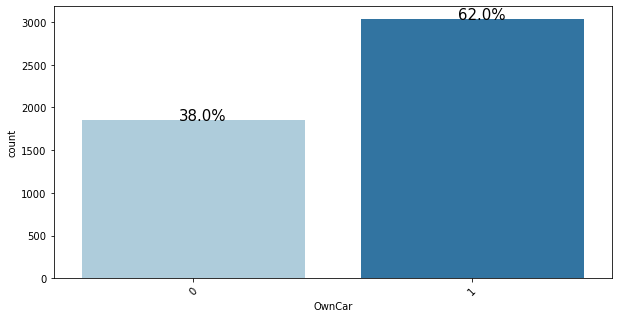

In [35]:
barPlot_percentDist('OwnCar')

* 62% customers have their own cars.

#### plot for Designation

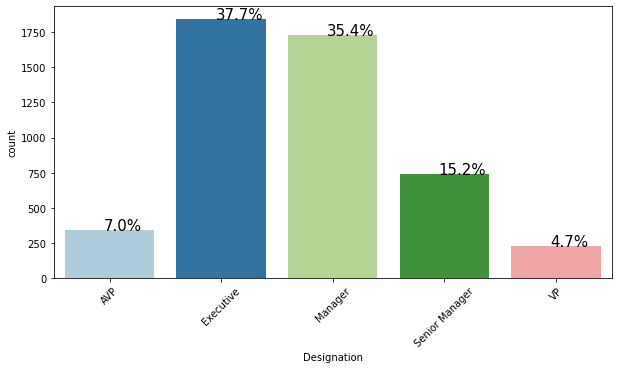

In [36]:
barPlot_percentDist('Designation')



* 37.7% customers taken prod had Executive designation followed by 35.4% were Manager and 15.2% were senior manager.


### 3.4.c Bivariant Plots

#### pair plot
plotting relationship of continuous variables with each other and personal_Loan variable

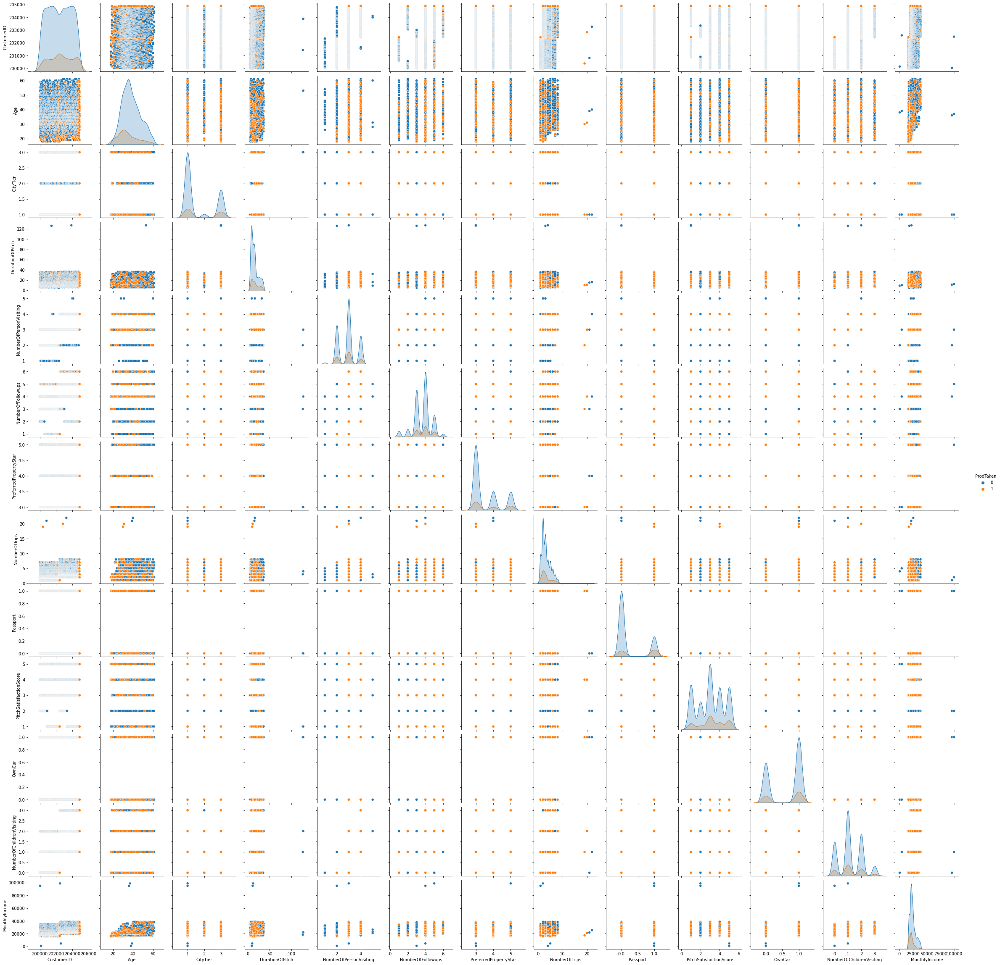

In [37]:
df_pair = df[['Age','DurationOfPitch','NumberOfPersonVisiting','NumberOfFollowups','NumberOfTrips','NumberOfChildrenVisiting','MonthlyIncome','ProdTaken']]
sns.pairplot(df,hue='ProdTaken')




* most of the Customers who took product have age range 20-60 with hightest denisity 20-40 years. 
* it seems that Most of the customer taken prod visited in group of 3-4 members but need to futher analyze.
* Most of the cutomers taken product had 4-6 follows . But need to further analyze.
* Most of the custoemrs taken prod had max 4 trips.


### 3.4.c HeatMap

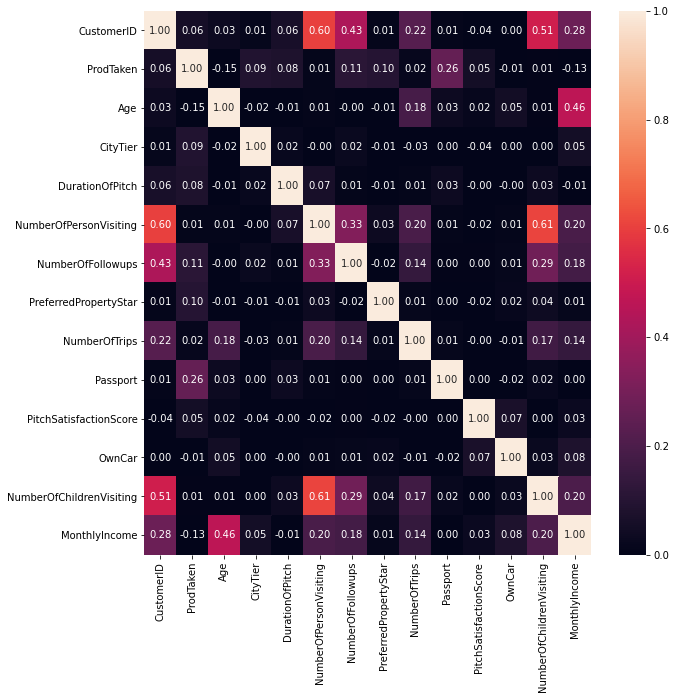

In [38]:
plt.figure(figsize=(10,10))

sns.heatmap(df.corr(),vmin=0,vmax=1,fmt='.2f',annot=True)
plt.show()

* NumberOFChildVisiting is correleted to numberOfPErsonVisiting which makes sense.
* Age has some correlation with Monthly income.
* MonthlyIncome is slightly correalted to prodTaken.


### 3.4.e Plotting relationship of customer's information  with ProdTaken

In [39]:
### Function to plot stacked bar charts for categorical columns
def stacked_plot(x):
    sns.set(palette='nipy_spectral')
    tab1 = pd.crosstab(x,df['ProdTaken'],margins=True)
    print(tab1)
    print('-'*120)
    tab = pd.crosstab(x,df['ProdTaken'],normalize='index')
    tab.plot(kind='bar',stacked=True,figsize=(10,5))
    plt.legend(loc='lower left', frameon=False)
    plt.legend(loc="upper left", bbox_to_anchor=(1,1))
    plt.show()

ProdTaken     0    1   All
CityTier                  
1          2670  520  3190
2           152   46   198
3          1146  354  1500
All        3968  920  4888
------------------------------------------------------------------------------------------------------------------------


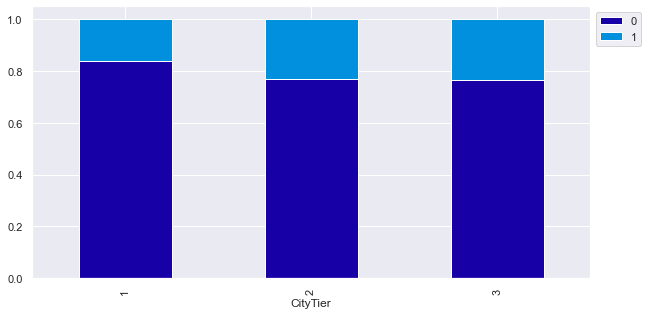

In [40]:
cols = df[['CityTier','Occupation','Designation','Gender','OwnCar','Passport']].columns.tolist()

stacked_plot(df['CityTier'])          

* Alomst 20% customers who are from city tier 2 and 3 had taken product.

ProdTaken          0    1   All
ProductPitched                 
Basic           1290  552  1842
Deluxe          1528  204  1732
King             210   20   230
Standard         618  124   742
Super Deluxe     322   20   342
All             3968  920  4888
------------------------------------------------------------------------------------------------------------------------


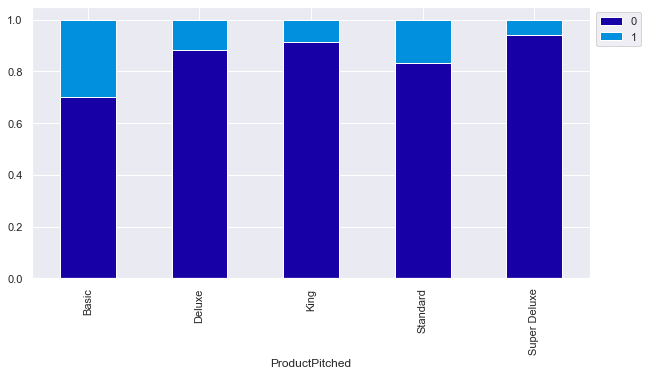

In [41]:
#ProductPitched
stacked_plot(df['ProductPitched'])

* Almost 30% customers who got  pitch for `Basic` package, bought the package followed by 18% cutomer who got pitch for `Standard` package , buoght the package.

ProdTaken          0    1   All
Occupation                     
Free Lancer        0    2     2
Large Business   314  120   434
Salaried        1954  414  2368
Small Business  1700  384  2084
All             3968  920  4888
------------------------------------------------------------------------------------------------------------------------


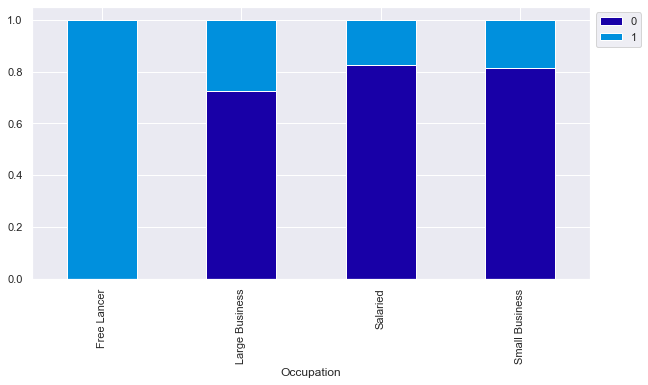

In [42]:
stacked_plot(df['Occupation'])

* it shows that all of freelancers had taken product but we can see from univariant plot that count of freelancer customer is almost 0%.
* 30% customers having large business had taken prodcut.

ProdTaken          0    1   All
Designation                    
AVP              322   20   342
Executive       1290  552  1842
Manager         1528  204  1732
Senior Manager   618  124   742
VP               210   20   230
All             3968  920  4888
------------------------------------------------------------------------------------------------------------------------


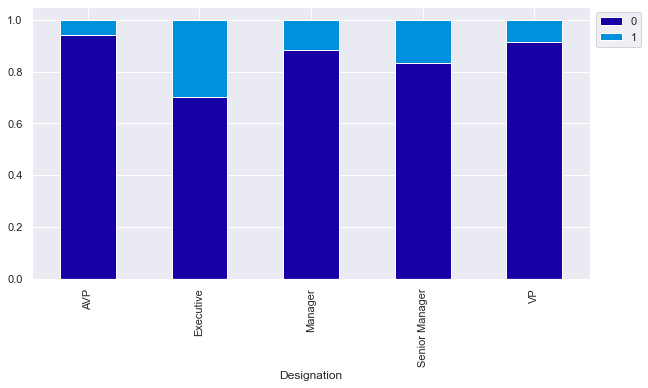

In [43]:
stacked_plot(df['Designation'])

* 30% cutomers who are Executives had taken product.

ProdTaken     0    1   All
Gender                    
Female     1630  342  1972
Male       2338  578  2916
All        3968  920  4888
------------------------------------------------------------------------------------------------------------------------


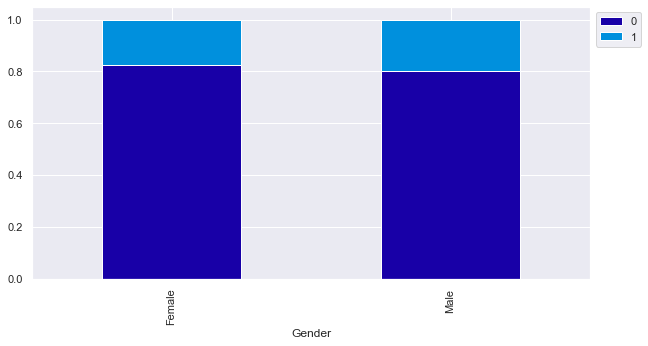

In [44]:
stacked_plot(df['Gender'])

* Percentage of female customer taken product is same as % of male cutomer taken product.

ProdTaken     0    1   All
OwnCar                    
0          1496  360  1856
1          2472  560  3032
All        3968  920  4888
------------------------------------------------------------------------------------------------------------------------


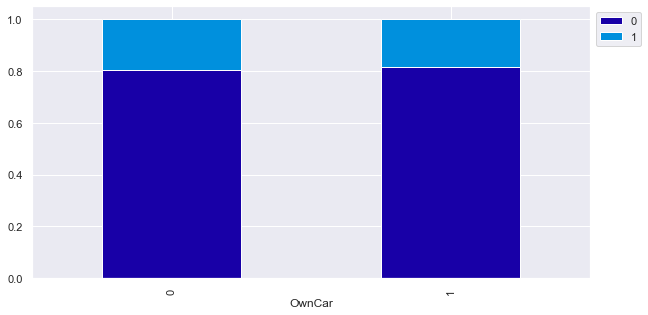

In [45]:
stacked_plot(df['OwnCar'])

* Percentage of customer owning car and taken product is same as % of cutomer not owning car but taken product.

ProdTaken     0    1   All
Passport                  
0          3040  426  3466
1           928  494  1422
All        3968  920  4888
------------------------------------------------------------------------------------------------------------------------


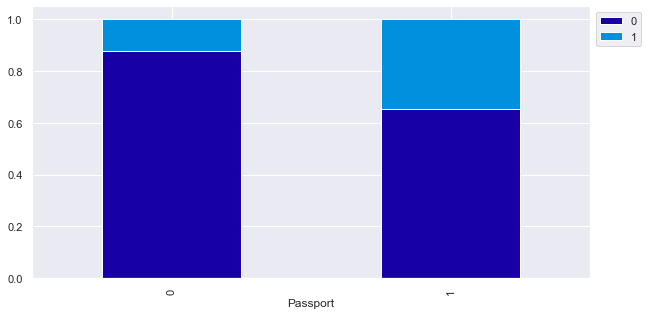

In [46]:
stacked_plot(df['Passport'])

* 35% customers who had passport took product.

ProdTaken         0    1   All
MaritalStatus                 
Divorced        826  124   950
Married        2014  326  2340
Single          612  304   916
Unmarried       516  166   682
All            3968  920  4888
------------------------------------------------------------------------------------------------------------------------


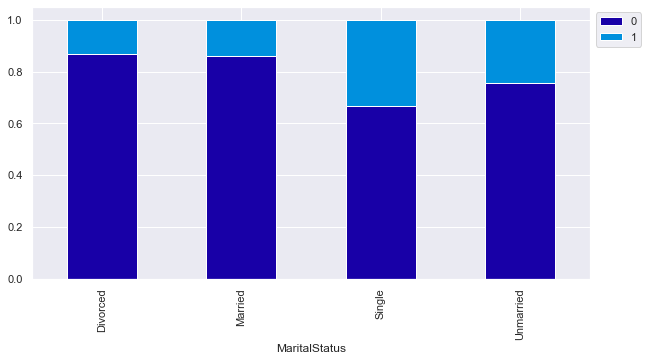

In [47]:
stacked_plot(df['MaritalStatus'])

* Almost 30% single cutomers had taken product followed by 25% unmarried customers.
* Percentage for Divorced and Married is alost same.

<AxesSubplot:xlabel='ProdTaken', ylabel='Age'>

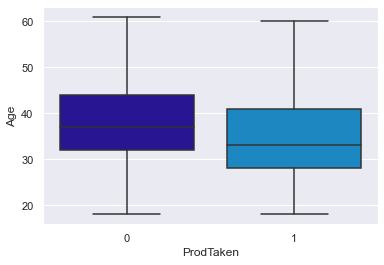

In [48]:
sns.boxplot(x='ProdTaken',y='Age',data= df)

In [49]:
df[['Age','ProdTaken']].groupby('ProdTaken').min()

,Age
ProdTaken,
0,18.0
1,18.0


In [50]:
df[['Age','ProdTaken']].groupby('ProdTaken').max()

,Age
ProdTaken,
0,61.0
1,60.0


* There is not a large difference of age between people taken and not taken products.
* 25% to 75% customer are og age between around 28-41 yrs. Min age of customers taken product is  18 yrs.


<AxesSubplot:xlabel='ProdTaken', ylabel='MonthlyIncome'>

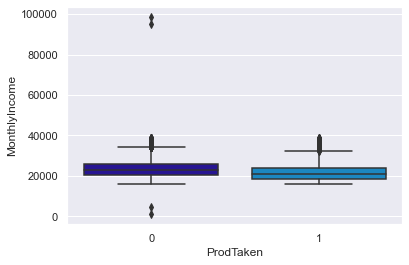

In [51]:
sns.boxplot(x='ProdTaken',y='MonthlyIncome',data= df)

In [52]:
df[['MonthlyIncome','ProdTaken']].groupby('ProdTaken').min()

,MonthlyIncome
ProdTaken,
0,1000.0
1,16009.0


In [53]:
df[['MonthlyIncome','ProdTaken']].groupby('ProdTaken').max()

,MonthlyIncome
ProdTaken,
0,98678.0
1,38537.0


* There is not a large difference between people taken and not taken products. The range of monthly income for customers taken products is 16009.0 - 38537.0

### 3.4.f plot between monthly income, age and ProdTaken

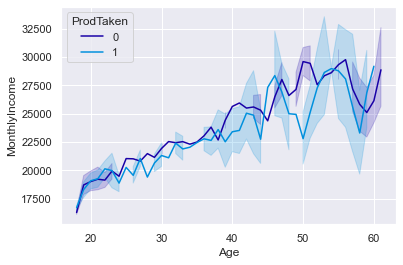

In [54]:
sns.lineplot(x='Age',y='MonthlyIncome', data=df, hue= 'ProdTaken');

* Definely monthlyIncome increase with increase of age but there is no  difference for prodTaken and not PRodTaken.

### 3.4.g Plotting relationship of customer's travel history  with ProdTaken

ProdTaken                  0    1   All
NumberOfPersonVisiting                 
1                         39    0    39
2                       1151  267  1418
3                       1942  460  2402
4                        833  193  1026
5                          3    0     3
All                     3968  920  4888
------------------------------------------------------------------------------------------------------------------------


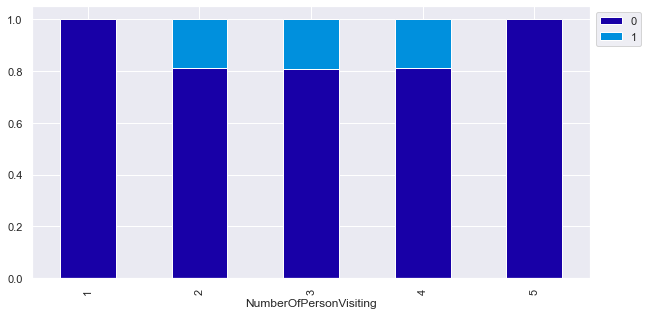

In [55]:
stacked_plot(df['NumberOfPersonVisiting'])

* There is no product taken when custtomer travelled with 1 persons or 5 persons.
* The percentage of customer taken prod is alomst same for numberofPersonVisiting 2,3 and 4. 

ProdTaken                 0    1   All
PreferredPropertyStar                 
3.0                    2511  482  2993
4.0                     731  182   913
5.0                     706  250   956
All                    3948  914  4862
------------------------------------------------------------------------------------------------------------------------


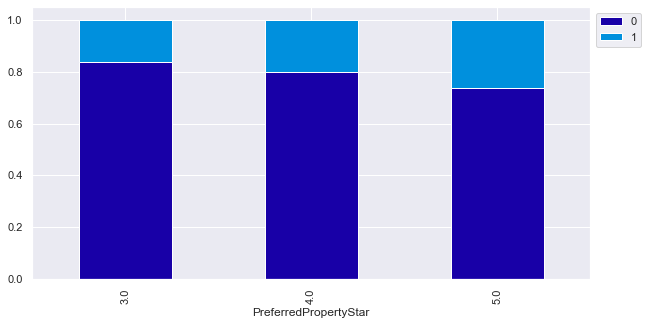

In [56]:
stacked_plot(df['PreferredPropertyStar'])

* There is an increase in customer counts who took product with increase in preferredpropertystar.

ProdTaken         0    1   All
NumberOfTrips                 
1.0             508  112   620
2.0            1165  299  1464
3.0             862  217  1079
4.0             417   61   478
5.0             396   62   458
6.0             258   64   322
7.0             156   62   218
8.0              76   29   105
19.0              0    1     1
20.0              0    1     1
21.0              1    0     1
22.0              1    0     1
All            3840  908  4748
------------------------------------------------------------------------------------------------------------------------


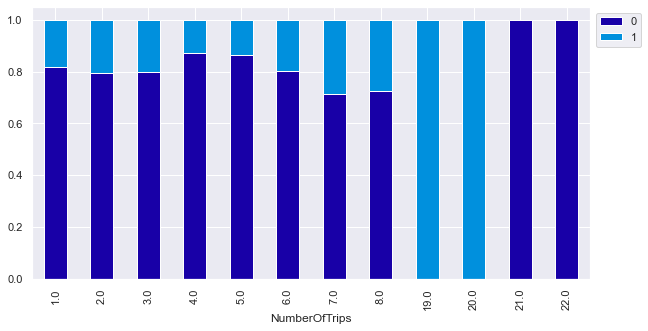

In [57]:
stacked_plot(df['NumberOfTrips'])

* all of the Customers who had 19 or 20 trips, had taken Product.
* All of the customer who had 21 and 22 trips , had not taken trips.
* there is a continuous increase in customer counts who took product from trip 4 to 8.

ProdTaken                    0    1   All
NumberOfChildrenVisiting                 
0.0                        880  202  1082
1.0                       1688  392  2080
2.0                       1082  253  1335
3.0                        259   66   325
All                       3909  913  4822
------------------------------------------------------------------------------------------------------------------------


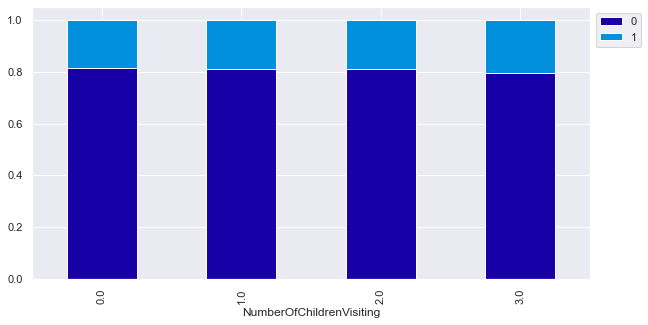

In [58]:
stacked_plot(df['NumberOfChildrenVisiting'])

* percentage of customer taken prod is same for different number of children visiting.

ProdTaken           0    1   All
TypeofContact                   
Company Invited  1109  310  1419
Self Enquiry     2837  607  3444
All              3946  917  4863
------------------------------------------------------------------------------------------------------------------------


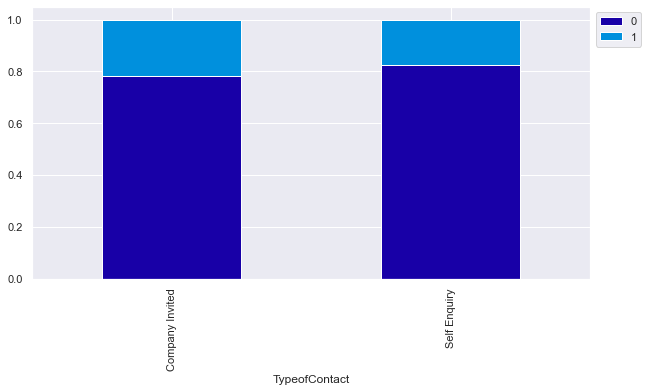

In [59]:
stacked_plot(df['TypeofContact'])

* Percentage of customer taken product is almost same for different typeOfContact.

### 3.4.h Plot between customeer interaction and ProdTaken

ProdTaken                  0    1   All
PitchSatisfactionScore                 
1                        798  144   942
2                        498   88   586
3                       1162  316  1478
4                        750  162   912
5                        760  210   970
All                     3968  920  4888
------------------------------------------------------------------------------------------------------------------------


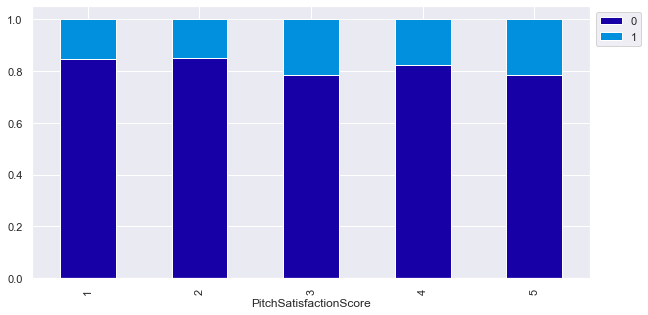

In [60]:
stacked_plot(df['PitchSatisfactionScore'])

* around 22% customers who gave pitch satisfaction score 3 or 5 took the product.
* percentage of  customers who accepted prod is almost same for different PitchSatisfactionScore.

ProdTaken          0    1   All
ProductPitched                 
Basic           1290  552  1842
Deluxe          1528  204  1732
King             210   20   230
Standard         618  124   742
Super Deluxe     322   20   342
All             3968  920  4888
------------------------------------------------------------------------------------------------------------------------


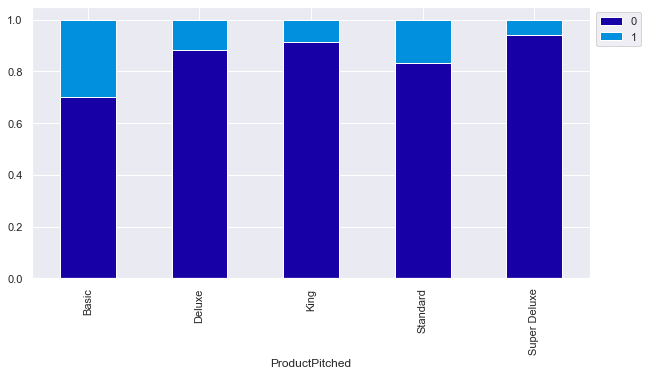

In [61]:
stacked_plot(df['ProductPitched'])

* 30% ofcustomer who got basic pitch took product followed by 20% who got standard pitch.

ProdTaken             0    1   All
NumberOfFollowups                 
1.0                 156   20   176
2.0                 205   24   229
3.0                1222  244  1466
4.0                1689  379  2068
5.0                 577  191   768
6.0                  82   54   136
All                3931  912  4843
------------------------------------------------------------------------------------------------------------------------


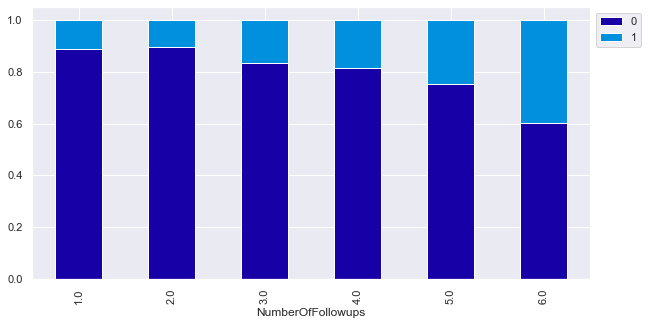

In [62]:
stacked_plot(df['NumberOfFollowups'])

* 40% cutomer who had 6 followups took the product followed by 25% cutomers who had 5 followups.
* the chances of customer taking product increase with number of followups.

ProdTaken           0    1   All
DurationOfPitch                 
5.0                 6    0     6
6.0               268   39   307
7.0               294   48   342
8.0               273   60   333
9.0               404   79   483
10.0              199   45   244
11.0              168   37   205
12.0              162   33   195
13.0              191   32   223
14.0              212   41   253
15.0              217   52   269
16.0              218   56   274
17.0              148   24   172
18.0               56   19    75
19.0               36   21    57
20.0               46   19    65
21.0               57   16    73
22.0               66   23    89
23.0               58   21    79
24.0               54   16    70
25.0               59   14    73
26.0               60   12    72
27.0               58   14    72
28.0               44   17    61
29.0               53   21    74
30.0               65   30    95
31.0               52   31    83
32.0               59   15    74
33.0      

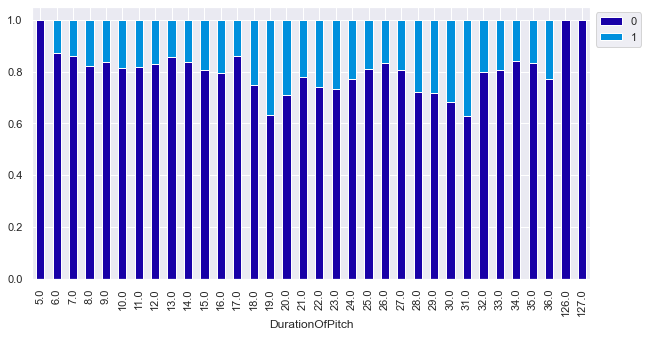

In [63]:
stacked_plot(df['DurationOfPitch'])

* 40% of customer who got 19.0 and 31.0 min pitch took thr product.
* Customers who got 5 min and too long pitch(126.0 and 127.0) did not take the product.

### 3.4.i Category plot - Plot of NumberOfPersonVisiting, MonthlyIncome and Occupation with ProdTaken

<Figure size 2880x2880 with 0 Axes>

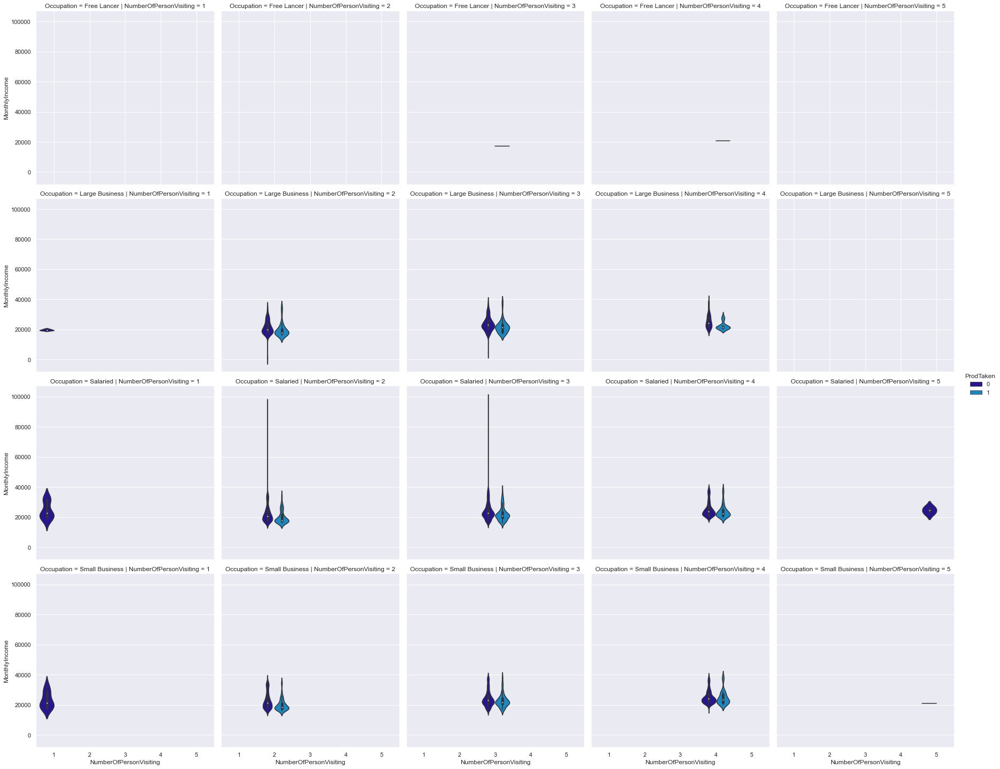

In [64]:


plt.figure(figsize=(40,40))
sns.catplot(x ='NumberOfPersonVisiting', y = 'MonthlyIncome',row = 'Occupation',col = 'NumberOfPersonVisiting',hue='ProdTaken',data = df, kind = 'violin' );
plt.show()

* There is no significant record for customers with occupation "Free lanser" who travelled in any sdize of group.
* No customer who travelled with 1 or 5 persons took the product.
* Customers who had any occupation except free lancer and travel in group of 2,3 and 4 actually took product.




In [65]:
df[['NumberOfPersonVisiting','Occupation','ProdTaken','CustomerID']].groupby(by=['NumberOfPersonVisiting','Occupation','ProdTaken']).count()

CustomerID
NumberOfPersonVisiting Occupation     ProdTaken            
1                      Free Lancer    0                 NaN
                                      1                 NaN
                       Large Business 0                 3.0
                                      1                 NaN
                       Salaried       0                17.0
                                      1                 NaN
                       Small Business 0                19.0
                                      1                 NaN
2                      Free Lancer    0                 NaN
                                      1                 NaN
                       Large Business 0                93.0
                                      1                39.0
                       Salaried       0               573.0
                                      1               110.0
                       Small Business 0               485.0
                                      1               118.0
3                      Free Lancer    0                 NaN
                                      1                 1.0
                       Large Business 0               154.0
                                      1                60.0
                       Salaried       0               958.0
                                      1               207.0
                       Small Business 0               830.0
                                      1               192.0
4                      Free Lancer    0                 NaN
                                      1                 1.0
                       Large Business 0                64.0
                                      1                21.0
                       Salaried       0               404.0
                                      1                97.0
                       Small Business 0               365.0
                                      1                74.0
5                      Free Lancer    0                 NaN
                                      1                 NaN
                       Large Business 0                 NaN
                                      1                 NaN
                       Salaried       0                 2.0
                                      1                 NaN
                       Small Business 0                 1.0
                                      1                 NaN

### 3.4.j Category plot  -Plot between prodTaken and MaritalStatus, ProductPitched,PreferredPropertyStar

<Figure size 2880x2880 with 0 Axes>

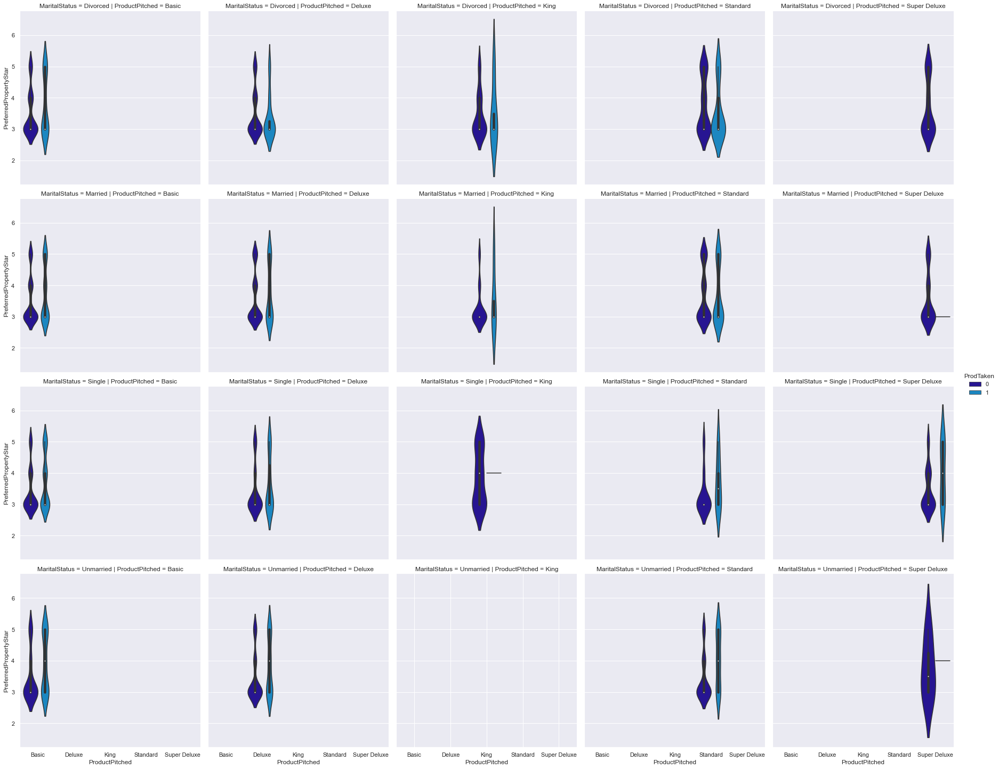

In [66]:


plt.figure(figsize=(40,40))
sns.catplot(x ='ProductPitched', y = 'PreferredPropertyStar',row = 'MaritalStatus',col = 'ProductPitched',hue='ProdTaken',data = df, kind = 'violin' );
plt.show()

* None except customer with marrital status "Single" has taken super deluxe product and they took of 3,4,5 mostly.
* There is no customer who is unmarried and bought king package followed by single cutomers who rarely took king package.
* Most preferrable hotel stars for all of the packages are 3,4,5.

### 3.4.k Category plot - Plot between prodTaken and Occupation, ProductPitched,PreferredPropertyStar

<Figure size 2880x2880 with 0 Axes>

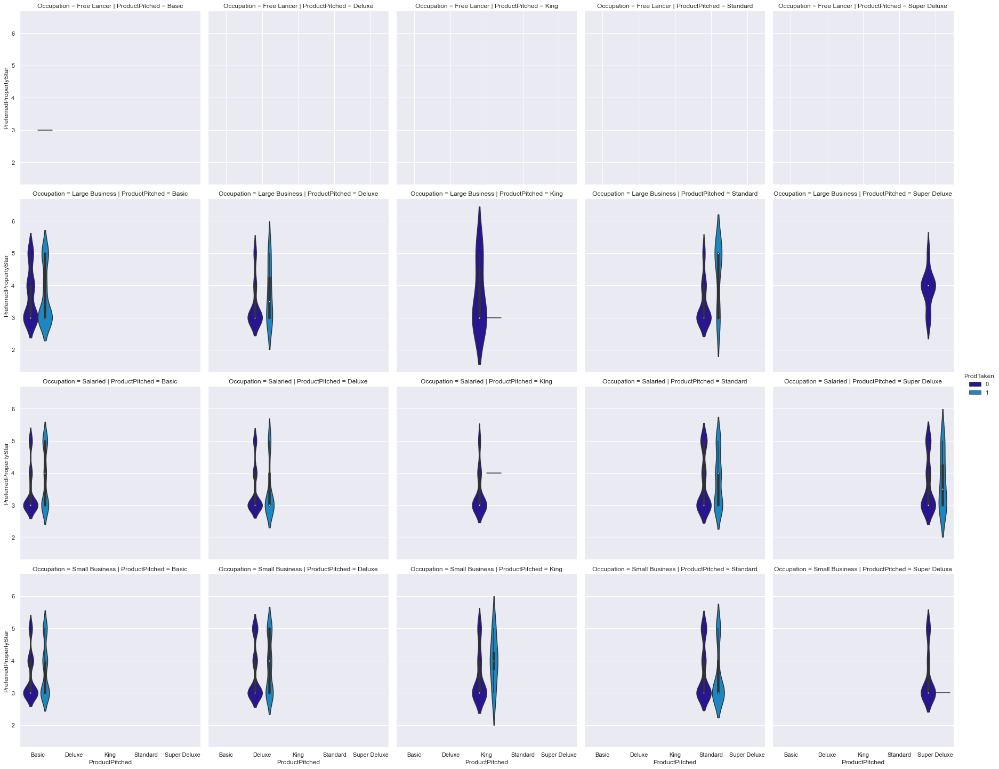

In [67]:
#Plot between prodTaken and Occupation, ProductPitched,PreferredPropertyStar

plt.figure(figsize=(40,40))
sns.catplot(x ='ProductPitched', y = 'PreferredPropertyStar',row = 'Occupation',col = 'ProductPitched',hue='ProdTaken',data = df, kind = 'violin' );
plt.show()

* Customers who have occupation "Free lancer" don't have travelling records excpt a few for basic package and preferred hotel star 3.
* Customers who have occupation " Large Business" did not take super deluxe and king packages. For other packages (King, Basic and Deluxe), they preferred hotel star either 3 or 5.
* Customers who have occupation " salaried" rarely took king packages. For other packages (King, Basic,super deluxe and Deluxe), they preferred hotel star either 3 or 5. 
* Customers who have occupation " small business" rarely took Super Deluxe packages. For other packages (King, Basic,king and Deluxe), they preferred hotel star 3,4 or 5. 

### 3.4.l Category plot - Plot of MarritalStatus, MonthlyIncome and ProdPitched with ProdTaken

In [170]:
#Plot between prodTaken and Occupation, ProductPitched,PreferredPropertyStar

plt.figure(figsize=(40,40))
sns.catplot(x ='ProductPitched', y = 'MonthlyIncome',row = 'MaritalStatus',col = 'ProductPitched',hue='ProdTaken',data = df, kind = 'violin' );
plt.show()

ValueError: Could not interpret input 'MonthlyIncome'

<Figure size 2880x2880 with 0 Axes>

### 3.4.m Category plot - Plot of MarritalStatus, age and ProdPitched with ProdTaken

In [ ]:
#Plot between prodTaken and Occupation, ProductPitched,PreferredPropertyStar

plt.figure(figsize=(40,40))
sns.catplot(x ='ProductPitched', y = 'Age',row = 'MaritalStatus4',col = 'ProductPitched',hue='ProdTaken',data = df, kind = 'violin' );
plt.show()

* basic : Age is around 15-65 for customer took this package.
* Deluxe : Age is around 15-65 for customer took this package.
* King : Age is around 32-65yr for married and divorced customer who took package. For single customer, age range is 10-75 yr and unmariied did not take the product.
* Standard : Age is around 10-70yr  customer who took package. 
* Super Deluxe: Age is around 35-65yr  customer who took package.

## 4. Insights based on EDA


* the chances of customer taking product increase with number of followups.
* 37.7% customers got Basic pitch followed by 35.4% got deluxe pitch. 15.2% customer got pitch for standard package.
* Almost 50% of customers are married. 
* Only 30% customers have passport.
* Most of the Customers who took product have age range 20-60 with hightest denisity 20-40 years. There is not a large difference of age between people taken and not taken products. 25% to 75% customers who took package have age between around 28-41 yrs. Min age of customers taken product is 18 yrs.
* It seems that Most of the customer taken prod visited in group of 3-4 members. No customer who travelled with 1 or 5 person took the product.
* Most of the cutomers taken product had 4-6 follows . But need to further analyze.
* Most of the custoemrs taken prod had max 4 trips.
* More Customers who had passport endup buying package.



#### Marrital Status Specific:
* None except customer with marrital status "Single" has taken super deluxe product and they took of 3,4,5 mostly.
* There is no customer who is unmarried and bought king package followed by single cutomers who rarely took king package.
* Most preferrable hotel stars for all of the packages are 3,4,5.

#### Package Specific : 
* Almost 30% customers who got pitch for Basic package, bought the package followed by 18% cutomer who got pitch for Standard package , buoght the package.
* Customers who have occupation "Free lancer" don't have travelling records excpt a few for basic package and preferred hotel star 3.
* Customers who had any occupation except free lancer and travel in group of 2,3 and 4 actually took product.
* Customers who have occupation " Large Business" did not take super deluxe and king packages. For other packages (King, Basic and Deluxe), they preferred hotel star either 3 or 5.
* Customers who have occupation " salaried" rarely took king packages. For other packages (King, Basic,super deluxe and Deluxe), they preferred hotel star either 3 or 5. 
* Customers who have occupation " small business" rarely took Super Deluxe packages. For other packages (King, Basic,king and Deluxe), they preferred hotel star 3,4 or 5.

* Characterstics of customers of different packages:

* Basic:
        ** Customers who took basic package are of  all of the marrital status and preferred hotel stars 3 or 5. 
        ** No customer with occupation "Free Lancer" had taken product.
        ** Customer taken this product travelled in group of 2,3 and 4 persons.
        ** A few of Customers who have occupation "Free lancer" took basic package and preferred hotel star 3.
        ** Customers who have occupation " Large Business " took product and preferredhotel star 3 or 5.
        ** Customers who have occupation " salaried"  preferred hotel star either 3 or 5.
        ** Customers who have occupation " small business"  preferred hotel star 3,4 or 5.
* standard
        ** No customer with occupation "Free Lancer" had taken product.
        ** Customer taken this product travelled in group of 2,3 and 4 persons.
        ** No Free lancer customer bought this package.
        ** Customers who have occupation " Large Business " took product and preferredhotel star 3 or 5.
        ** Customers who have occupation " salaried"  preferred hotel star either 3 or 5.
        ** Customers who have occupation " small business"  preferred hotel star 3,4 or 5.
* Deluxe
        ** No customer with occupation "Free Lancer" had taken product.
        ** Customer taken this product travelled in group of 2,3 and 4 persons.
        ** No Free lancer customer bought this package.
        ** Customers who have occupation " Large Business " took product and preferredhotel star 3 or 5.
        ** Customers who have occupation " salaried"  preferred hotel star either 3 or 5.
        ** Customers who have occupation " small business"  preferred hotel star 3,4 or 5.
* Super Deluxe
        ** No customer with occupation "Free Lancer" had taken product.
        ** Customer taken this product travelled in group of 2,3 and 4 persons.
        ** Only customer with marrital status "Single" has taken super deluxe product and they preferred hostel of star    3,4,5 mostly.
         ** No Free lancer customer bought this package.
         ** No Customers who have occupation " Large Business " took product.
         ** Customers who have occupation " salaried"  preferred hotel star either 3 or 5.
         ** Customers who have occupation " small business" rarely took Super Deluxe packages. 
* King
        ** No customer with occupation "Free Lancer" had taken product.
        ** Customer taken this product travelled in group of 2,3 and 4 persons.
        ** There is no customer who is unmarried and bought king package followed by single cutomers who rarely took king   package.
         ** No Free lancer customer bought this package.
         ** No Customers who have occupation " Large Business " took product.
         ** Customers who have occupation " salaried" rarely took king packages. 
         ** Customers who have occupation " small business"  preferred hotel star 3,4 or 5.
        
     





### 3. Data Pre-processing

#### 3. 1. Missing value Treatment

In [68]:
df.isnull().sum().sort_values(ascending=False).reset_index()


,index,0
0,DurationOfPitch,251
1,MonthlyIncome,233
2,Age,226
3,NumberOfTrips,140
4,NumberOfChildrenVisiting,66
5,NumberOfFollowups,45
6,PreferredPropertyStar,26
7,TypeofContact,25
8,Passport,0
9,MaritalStatus,0


In [69]:
df_null = df.isnull().sum().sort_values(ascending=False).reset_index()
df_null.columns = ['columns','missing_counts']
df_null=df_null[df_null['missing_counts']>0]
df_null['columns']


0             DurationOfPitch
1               MonthlyIncome
2                         Age
3               NumberOfTrips
4    NumberOfChildrenVisiting
5           NumberOfFollowups
6       PreferredPropertyStar
7               TypeofContact
Name: columns, dtype: object

In [70]:
#### Dropping customerID as it's just id
df.drop(columns=['CustomerID'],inplace=True)

#### Treating Missing value of continuous variable (DurationOfPitch, MonthlyIncome, Age)


In [71]:
##Duration of pitch
print('Number of missing value in Duration of pitch \t%s' %df['DurationOfPitch'].isnull().sum())
df['DurationOfPitch']=df['DurationOfPitch'].fillna(df['DurationOfPitch'].mean())
print('Number of missing value in Duration of pitch after replacing missing value \t%s' %df['DurationOfPitch'].isnull().sum())

Number of missing value in Duration of pitch 	251
Number of missing value in Duration of pitch after replacing missing value 	0


In [72]:
##MonthlyIncome
print('Number of missing value in monthyl income \t%s' %df['MonthlyIncome'].isnull().sum())
df['MonthlyIncome']=df['MonthlyIncome'].fillna(df['MonthlyIncome'].mean())
print('Number of missing value in MonthlyIncome after replacing missing value \t%s' %df['MonthlyIncome'].isnull().sum())

Number of missing value in monthyl income 	233
Number of missing value in MonthlyIncome after replacing missing value 	0


In [73]:
## Age
print('Number of missing value in Age \t%s' %df['Age'].isnull().sum())
df['Age']=df['Age'].fillna(df['Age'].mean())
print('Number of missing value in Age after replacing missing value \t%s' %df['Age'].isnull().sum())

Number of missing value in Age 	226
Number of missing value in Age after replacing missing value 	0


#### Treating Missing value of continuous variable (NumberOfTrips,   NumberOfChildrenVisiting,  NumberOfFollowups, PreferredPropertyStar, TypeofContact)

In [74]:
##NumberOfTrips
print('Number of missing value in NumberOfTrips \t%s' %df['NumberOfTrips'].isnull().sum())
df['NumberOfTrips']=df['NumberOfTrips'].fillna(df['NumberOfTrips'].median())
print('Number of missing value in NumberOfTrips after replacing missing value \t%s' %df['NumberOfTrips'].isnull().sum())

Number of missing value in NumberOfTrips 	140
Number of missing value in NumberOfTrips after replacing missing value 	0


In [75]:
##NumberOfChildrenVisiting
print('Number of missing value in NumberOfChildrenVisiting \t%s' %df['NumberOfChildrenVisiting'].isnull().sum())
df['NumberOfChildrenVisiting']=df['NumberOfChildrenVisiting'].fillna(df['NumberOfChildrenVisiting'].median())
print('Number of missing value in NumberOfChildrenVisiting after replacing missing value \t%s' %df['NumberOfChildrenVisiting'].isnull().sum())

Number of missing value in NumberOfChildrenVisiting 	66
Number of missing value in NumberOfChildrenVisiting after replacing missing value 	0


In [76]:
##NumberOfFollowups
print('Number of missing value in NumberOfFollowups \t%s' %df['NumberOfFollowups'].isnull().sum())
df['NumberOfFollowups']=df['NumberOfFollowups'].fillna(df['NumberOfFollowups'].median())
print('Number of missing value in NumberOfFollowups after replacing missing value \t%s' %df['NumberOfFollowups'].isnull().sum())

Number of missing value in NumberOfFollowups 	45
Number of missing value in NumberOfFollowups after replacing missing value 	0


In [77]:
##PreferredPropertyStar
print('Number of missing value in PreferredPropertyStar \t%s' %df['PreferredPropertyStar'].isnull().sum())
df['PreferredPropertyStar']=df['PreferredPropertyStar'].fillna(df['PreferredPropertyStar'].median())
print('Number of missing value in PreferredPropertyStar after replacing missing value \t%s' %df['PreferredPropertyStar'].isnull().sum())

Number of missing value in PreferredPropertyStar 	26
Number of missing value in PreferredPropertyStar after replacing missing value 	0


In [78]:
df['TypeofContact'].mode()

0    Self Enquiry
Name: TypeofContact, dtype: category
Categories (2, object): ['Company Invited', 'Self Enquiry']

In [79]:
df['TypeofContact'].value_counts(dropna=False)

Self Enquiry       3444
Company Invited    1419
NaN                  25
Name: TypeofContact, dtype: int64

In [80]:
##TypeofContact
print('Number of missing value in TypeofContact \t%s' %df['TypeofContact'].isnull().sum())
df['TypeofContact'].fillna('Self Enquiry',inplace=True)
print('Number of missing value in TypeofContact after replacing missing value \t%s' %df['TypeofContact'].isna().sum())

Number of missing value in TypeofContact 	25
Number of missing value in TypeofContact after replacing missing value 	0


In [81]:
df['TypeofContact'].value_counts(dropna=False)

Self Enquiry       3469
Company Invited    1419
Name: TypeofContact, dtype: int64

### Outlier Treatment and Feature Engineering (scaling)

* The following columns MonthlyIncome, DurationOfPitch, NumberOfPersonVisiting, NumberOfFollowups, NumberOfTrips have outliers. 
* the scale of MonthlyIncome is very large  in comparison to other columns so it requires scaling too.
* We can first use ROBust scalar and see if it solve outlier and scaling issue in these variables.


#### 3.2 Scaling of `Age` and `MonthlyIncome`

In [82]:
def plot_transformation_After(df,var,t):
    plt.subplot(121)
    p1=t.fit_transform(df[[var]]).flatten()
    sns.kdeplot(p1)
    plt.title('After transformation kde ')
    
    plt.subplot(122)
    sns.boxplot(p1)
    plt.title('After transformation box plot')

In [83]:
def plots_Transform_before(df,var):
    plt.figure(figsize=(8,5))
    plt.subplot(121)
    sns.kdeplot(df[var])
    plt.title('Before transformation kde ')
    
    plt.figure(figsize=(8,5))
    plt.subplot(122)
    sns.boxplot(df[var])
    plt.title('Before transformation box plot ')
    
   

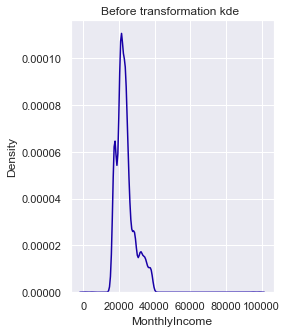

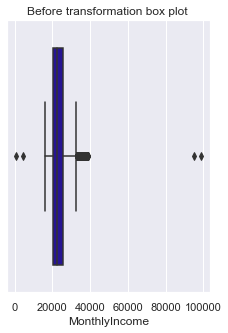

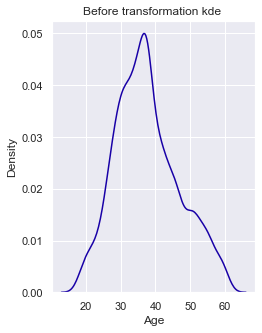

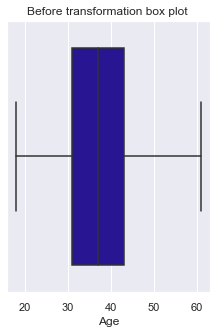

In [84]:
cols = ['MonthlyIncome','Age']
scalar = RobustScaler()
for col in cols:
   plots_Transform_before(df,col) 

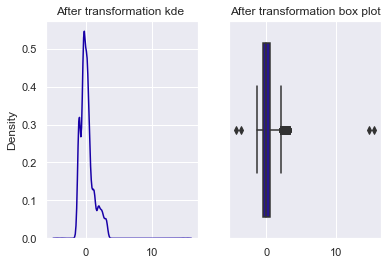

In [85]:
plot_transformation_After(df,'MonthlyIncome',scalar) 

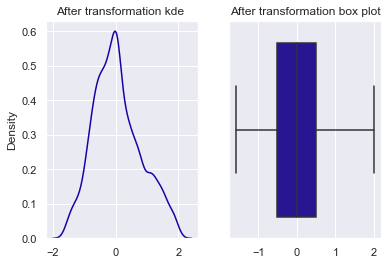

In [86]:
plot_transformation_After(df,'Age',scalar) 

#### Robust transfromation of Age

In [87]:
##scaling Age
df['Age_scaled']=scalar.fit_transform(df[['Age']]).flatten()
df['Age_scaled']

0       0.333333
1       1.000000
2       0.000000
3      -0.333333
4       0.051855
          ...   
4883    1.000000
4884   -0.750000
4885    1.250000
4886   -1.500000
4887   -0.083333
Name: Age_scaled, Length: 4888, dtype: float64

#### Robust transformation of monthly income

In [88]:
df['MonthlyIncome_scaled']=scalar.fit_transform(df[['MonthlyIncome']]).flatten()
df['MonthlyIncome_scaled']

0      -0.336454
1      -0.511159
2      -1.126575
3      -0.960777
4      -0.847614
          ...   
4883    0.793765
4884   -0.292120
4885    1.855357
4886   -0.478972
4887    0.280581
Name: MonthlyIncome_scaled, Length: 4888, dtype: float64

In [89]:
df.drop(columns=['MonthlyIncome','Age'], inplace=True)

* As robust scaler does not treat the outlier so we still need to treat the outliers.So we need to handle outliers afterwards

#### 3.3  Outlier treatment for MonthlyIncome,DurationOfPitch,NumberOfPersonVisiting,NumberOfFollowups,NumberOfTrips

In [90]:
def treat_outliers(data,col):
    '''
    treats outliers in a varaible
    col: str, name of the numerical varaible
    data: data frame
    col: name of the column
    '''
    Q1=data[col].quantile(0.25) # 25th quantile
    Q3=data[col].quantile(0.75)  # 75th quantile
    IQR=Q3-Q1
    Lower_Whisker = Q1 - 1.5*IQR 
    Upper_Whisker = Q3 + 1.5*IQR
    data[col] = np.clip(data[col], Lower_Whisker, Upper_Whisker) # all the values samller than Lower_Whisker will be assigned value of Lower_whisker 
                                                            # and all the values above upper_whishker will be assigned value of upper_Whisker 
    return data

In [91]:
def plot_box(df,col):
    ## verifying if all outliers are treated
    sns.boxplot(data=df,x=col);
    
    plt.title(col)          
    plt.show()

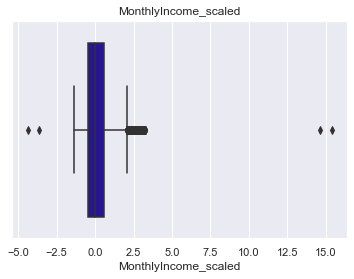

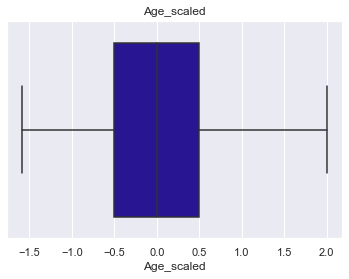

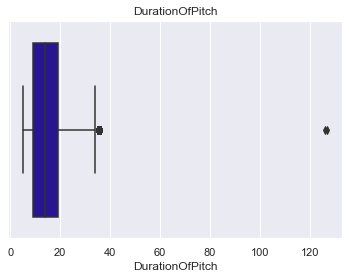

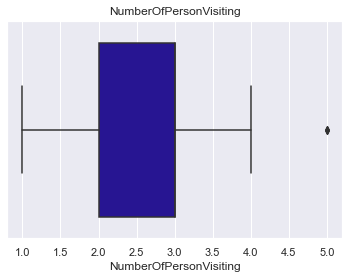

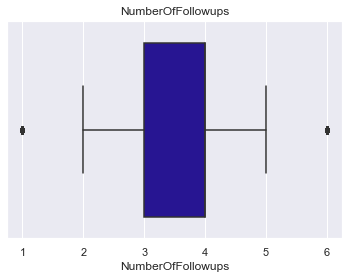

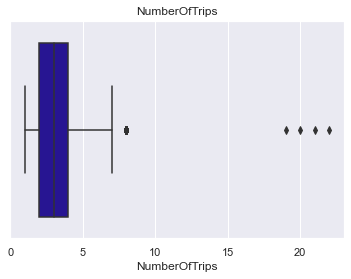

In [92]:
#### Checking outliers
cols_outlier = ['MonthlyIncome_scaled','Age_scaled','DurationOfPitch','NumberOfPersonVisiting','NumberOfFollowups','NumberOfTrips']

for col in cols_outlier:
    plot_box(df,col)
    

In [93]:
col_outlier = ['MonthlyIncome_scaled','Age_scaled','DurationOfPitch','NumberOfPersonVisiting','NumberOfFollowups','NumberOfTrips']
for c in col_outlier:
    df = treat_outliers(df,c)

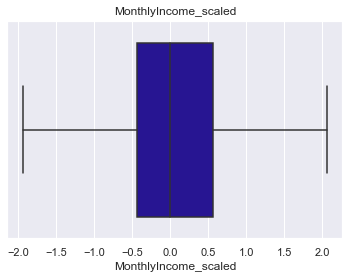

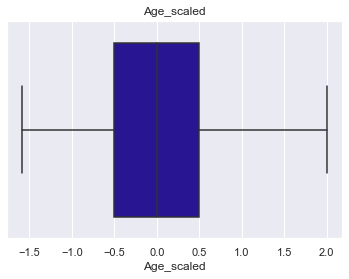

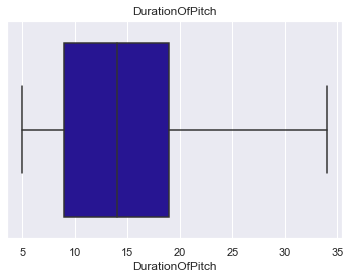

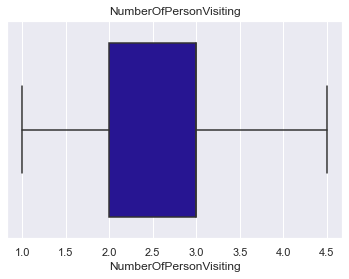

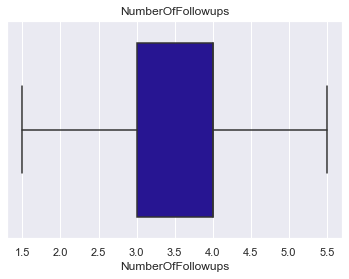

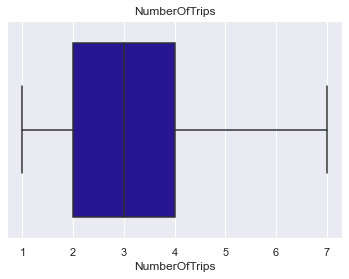

In [94]:
####verifying if outliers are treated
for col in cols_outlier:
    plot_box(df,col)

#### 3.4  Prepare data for model building

In [95]:
df.columns

Index(['ProdTaken', 'TypeofContact', 'CityTier', 'DurationOfPitch',
       'Occupation', 'Gender', 'NumberOfPersonVisiting', 'NumberOfFollowups',
       'ProductPitched', 'PreferredPropertyStar', 'MaritalStatus',
       'NumberOfTrips', 'Passport', 'PitchSatisfactionScore', 'OwnCar',
       'NumberOfChildrenVisiting', 'Designation', 'Age_scaled',
       'MonthlyIncome_scaled'],
      dtype='object')

In [96]:
X = df.drop(['ProdTaken'], axis=1)
Y = df['ProdTaken']

In [97]:
X.info()

<class 'pandas.core.frame.DataFrame'>
RangeIndex: 4888 entries, 0 to 4887
Data columns (total 18 columns):
 #   Column                    Non-Null Count  Dtype   
---  ------                    --------------  -----   
 0   TypeofContact             4888 non-null   category
 1   CityTier                  4888 non-null   int64   
 2   DurationOfPitch           4888 non-null   float64 
 3   Occupation                4888 non-null   category
 4   Gender                    4888 non-null   object  
 5   NumberOfPersonVisiting    4888 non-null   float64 
 6   NumberOfFollowups         4888 non-null   float64 
 7   ProductPitched            4888 non-null   category
 8   PreferredPropertyStar     4888 non-null   float64 
 9   MaritalStatus             4888 non-null   category
 10  NumberOfTrips             4888 non-null   float64 
 11  Passport                  4888 non-null   int64   
 12  PitchSatisfactionScore    4888 non-null   int64   
 13  OwnCar                    4888 non-null   int64 

#### create dummies variables

In [98]:
cat_columns = df.select_dtypes(['category'])
#cat_columns=['TypeofContact','Occupation','ProductPitched','MaritalStatus','Designation']
#pd.get_dummies()
X = pd.get_dummies(X, columns =['Gender','TypeofContact','Occupation','ProductPitched','MaritalStatus','Designation'], drop_first=True)
X.head()

,CityTier,DurationOfPitch,NumberOfPersonVisiting,NumberOfFollowups,PreferredPropertyStar,NumberOfTrips,Passport,PitchSatisfactionScore,OwnCar,NumberOfChildrenVisiting,Age_scaled,MonthlyIncome_scaled,Gender_Male,TypeofContact_Self Enquiry,Occupation_Large Business,Occupation_Salaried,Occupation_Small Business,ProductPitched_Deluxe,ProductPitched_King,ProductPitched_Standard,ProductPitched_Super Deluxe,MaritalStatus_Married,MaritalStatus_Single,MaritalStatus_Unmarried,Designation_Executive,Designation_Manager,Designation_Senior Manager,Designation_VP
0,3,6.0,3.0,3.0,3.0,1.0,1,2,1,0.0,0.333333,-0.336454,0,1,0,1,0,1,0,0,0,0,1,0,0,1,0,0
1,1,14.0,3.0,4.0,4.0,2.0,0,3,1,2.0,1.000000,-0.511159,1,0,0,1,0,1,0,0,0,0,0,0,0,1,0,0
2,1,8.0,3.0,4.0,3.0,7.0,1,3,0,0.0,0.000000,-1.126575,1,1,0,0,0,0,0,0,0,0,1,0,1,0,0,0
3,1,9.0,2.0,3.0,3.0,2.0,1,5,1,1.0,-0.333333,-0.960777,0,0,0,1,0,0,0,0,0,0,0,0,1,0,0,0
4,1,8.0,2.0,3.0,4.0,1.0,0,5,1,0.0,0.051855,-0.847614,1,1,0,0,1,0,0,0,0,0,0,0,1,0,0,0


#### Splitting Test and Training data

In [99]:
#Splitting data in train and test sets
X_train,X_test,y_train,y_test=train_test_split(X, Y, test_size=0.3, random_state=1,stratify=Y)

In [100]:
X_train.shape

(3421, 28)

In [101]:
y_test.shape

(1467,)

### 4. Model Building and evaluating performance

#### * Funtions to show different metrices and confusion matrix


In [102]:
def get_recall_score(model,flag=True):
    '''
    model : classifier to predict values of X

    '''
    a = [] # defining an empty list to store train and test results
    pred_train = model.predict(X_train)
    pred_test = model.predict(X_test)
    train_recall = metrics.recall_score(y_train,pred_train)
    test_recall = metrics.recall_score(y_test,pred_test)
    a.append(train_recall) # adding train recall to list 
    a.append(test_recall) # adding test recall to list
    if flag == True: # If the flag is set to True then only the following print statements will be dispayed
        print("Recall on training set : ",metrics.recall_score(y_train,pred_train))
        print("Recall on test set : ",metrics.recall_score(y_test,pred_test))
    
    return a # returning the list with train and test scores

In [103]:
##  Function to calculate precision score
def get_precision_score(model,flag=True):
    '''
    model : classifier to predict values of X

    '''
    b = []  # defining an empty list to store train and test results
    pred_train = model.predict(X_train)
    pred_test = model.predict(X_test)
    train_precision = metrics.precision_score(y_train,pred_train)
    test_precision = metrics.precision_score(y_test,pred_test)
    b.append(train_precision) # adding train precision to list
    b.append(test_precision) # adding test precision to list
    if flag == True: # If the flag is set to True then only the following print statements will be dispayed
        print("Precision on training set : ",metrics.precision_score(y_train,pred_train))
        print("Precision on test set : ",metrics.precision_score(y_test,pred_test))

    return b # returning the list with train and test scores

In [104]:
##  Function to calculate precision score
def get_f1_score(model,flag=True):
    '''
    model : classifier to predict values of X

    '''
    b = []  # defining an empty list to store train and test results
    pred_train = model.predict(X_train)
    pred_test = model.predict(X_test)
    train_f1score = metrics.f1_score(y_train,pred_train)
    test_f1score = metrics.f1_score(y_test,pred_test)
    b.append(train_f1score) # adding train precision to list
    b.append(test_f1score) # adding test precision to list
    if flag == True: # If the flag is set to True then only the following print statements will be dispayed
        print("f1 score on training set : ",metrics.f1_score(y_train,pred_train))
        print("f1 score  on test set : ",metrics.f1_score(y_test,pred_test))

    return b # returning the list with train and test scores

In [105]:
##  Function to calculate accuracy score
def get_accuracy_score(model,flag=True):
    '''
    model : classifier to predict values of X

    '''
    c = [] # defining an empty list to store train and test results
    train_acc = model.score(X_train,y_train)
    test_acc = model.score(X_test,y_test)
    c.append(train_acc) # adding train accuracy to list
    c.append(test_acc) # adding test accuracy to list
    if flag == True: # If the flag is set to True then only the following print statements will be dispayed
        print("Accuracy on training set : ",model.score(X_train,y_train))
        print("Accuracy on test set : ",model.score(X_test,y_test))
    
    return c # returning the list with train and test scores

In [106]:
def make_confusion_matrix(model,y_actual,labels=[1, 0]):
    '''
    model : classifier to predict values of X
    y_actual : ground truth  
    
    '''
    y_predict = model.predict(X_test)
    cm=metrics.confusion_matrix( y_actual, y_predict, labels=[0, 1])
    df_cm = pd.DataFrame(cm, index = [i for i in ["Actual - No","Actual - Yes"]],
                  columns = [i for i in ['Predicted - No','Predicted - Yes']])
    group_counts = ["{0:0.0f}".format(value) for value in
                cm.flatten()]
    group_percentages = ["{0:.2%}".format(value) for value in
                         cm.flatten()/np.sum(cm)]
    labels = [f"{v1}\n{v2}" for v1, v2 in
              zip(group_counts,group_percentages)]
    labels = np.asarray(labels).reshape(2,2)
    plt.figure(figsize = (10,7))
    sns.heatmap(df_cm, annot=labels,fmt='')
    plt.ylabel('True label')
    plt.xlabel('Predicted label')

## Build Decision Tree Model

* We will build our model using the DecisionTreeClassifier function. Using default 'gini' criteria to split. 
* If the frequency of class A is 10% and the frequency of class B is 90%, then class B will become the dominant class and the decision tree will become biased toward the dominant classes.

* In this case, we can pass a dictionary {0:0.17,1:0.83} to the model to specify the weight of each class and the decision tree will give more weightage to class 1.

* class_weight is a hyperparameter for the decision tree classifier.

In [107]:
dtree = DecisionTreeClassifier(criterion='gini',class_weight={0:0.17,1:0.83},random_state=1)

In [108]:
dtree.fit(X_train, y_train)

DecisionTreeClassifier(class_weight={0: 0.17, 1: 0.83}, random_state=1)

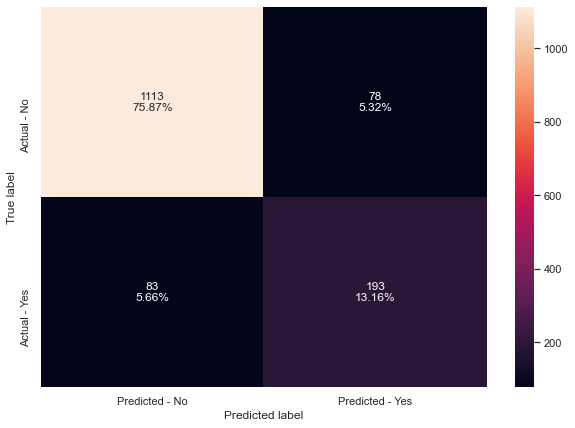

In [109]:
make_confusion_matrix(dtree,y_test)

**Confusion Matrix -**

* Cutomer took product and the model predicted it correctly that is customer will take production :  True Positive (observed=1,predicted=1)

* Customer didn't take product and the model predicted customer will take product : False Positive (observed=0,predicted=1)

* Customer didn't take product and the model predicted customer will not take product : True Negative (observed=0,predicted=0)

* Employee took product and the model predicted that customer won't take product : False Negative (observed=1,predicted=0)

In [110]:
dtree_acc = get_accuracy_score(dtree)
dtree_recall = get_recall_score(dtree)
dtree_precision = get_precision_score(dtree)
dtree_f1score  = get_f1_score(dtree)

Accuracy on training set :  1.0
Accuracy on test set :  0.8902522154055896
Recall on training set :  1.0
Recall on test set :  0.6992753623188406
Precision on training set :  1.0
Precision on test set :  0.7121771217712177
f1 score on training set :  1.0
f1 score  on test set :  0.7056672760511883


* Decision tree is overfitting to training data so even though acuracy, recall and precision is good,we can not generatizeworking well on the training.

### Bagging Classifier

In [111]:
bagging = BaggingClassifier(random_state=1)
bagging.fit(X_train,y_train)

BaggingClassifier(random_state=1)

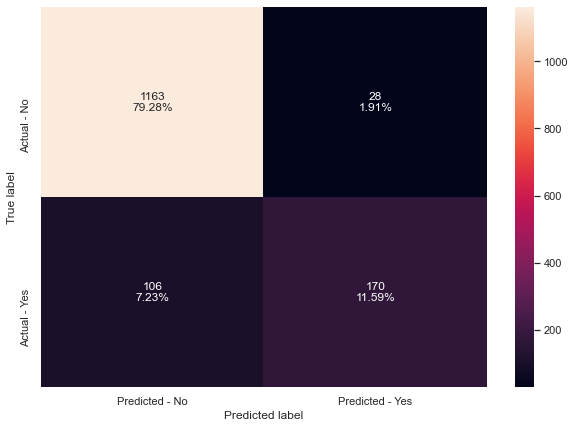

In [112]:
make_confusion_matrix(bagging,y_test)

In [113]:
bagging_acc = get_accuracy_score(bagging)
bagging_recall = get_recall_score(bagging)
bagging_precision = get_precision_score(bagging)
bagging_f1score  = get_f1_score(bagging)

Accuracy on training set :  0.994153756211634
Accuracy on test set :  0.9086571233810498
Recall on training set :  0.9704968944099379
Recall on test set :  0.6159420289855072
Precision on training set :  0.9984025559105432
Precision on test set :  0.8585858585858586
f1 score on training set :  0.984251968503937
f1 score  on test set :  0.7172995780590716


* Bagging classifier is overfitting on the training set and is performing poorly on the test set in terms of recall.

**Bagging Classifier with weighted decision tree**

In [114]:
bagging_wt = BaggingClassifier(base_estimator=DecisionTreeClassifier(criterion='gini',class_weight={0:0.17,1:0.83},random_state=1),random_state=1)
bagging_wt.fit(X_train,y_train)

BaggingClassifier(base_estimator=DecisionTreeClassifier(class_weight={0: 0.17,
                                                                      1: 0.83},
                                                        random_state=1),
                  random_state=1)

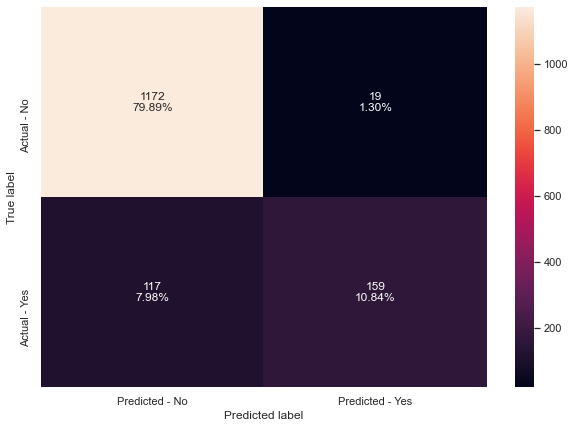

In [115]:
make_confusion_matrix(bagging_wt,y_test)

In [116]:
wt_bagging_acc = get_accuracy_score(bagging_wt)
wt_bagging_recall = get_recall_score(bagging_wt)
wt_bagging_precision = get_precision_score(bagging_wt)
wt_bagging_f1score  = get_f1_score(bagging_wt)

Accuracy on training set :  0.9918152586962876
Accuracy on test set :  0.907293796864349
Recall on training set :  0.9596273291925466
Recall on test set :  0.5760869565217391
Precision on training set :  0.9967741935483871
Precision on test set :  0.8932584269662921
f1 score on training set :  0.9778481012658228
f1 score  on test set :  0.7004405286343611


* Bagging classifier with a weighted decision tree is giving very good accuracy and prediction but is not able to generalize well on test data in terms of recall

#### Random Forest Classifier

In [117]:
rf = RandomForestClassifier(random_state=1)
rf.fit(X_train,y_train)

RandomForestClassifier(random_state=1)

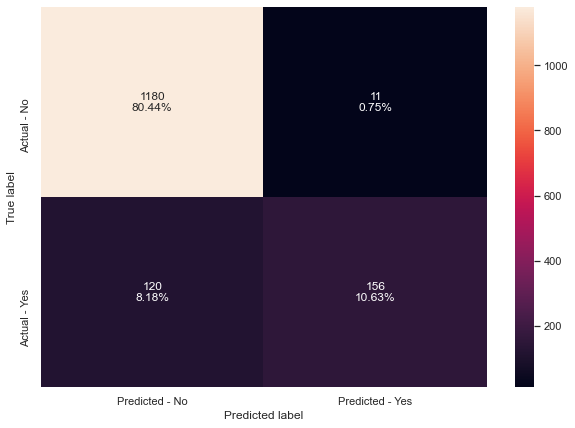

In [118]:
make_confusion_matrix(rf,y_test)

In [119]:
rf_acc = get_accuracy_score(rf)
rf_recall = get_recall_score(rf)
rf_precision = get_precision_score(rf)
rf_f1score  = get_f1_score(rf)

Accuracy on training set :  1.0
Accuracy on test set :  0.9107021131561008
Recall on training set :  1.0
Recall on test set :  0.5652173913043478
Precision on training set :  1.0
Precision on test set :  0.9341317365269461
f1 score on training set :  1.0
f1 score  on test set :  0.7042889390519187


* Random Forest has performed well in terms of accuracy and precision, but it is not able to generalize well on the test data in terms of recall. it is also overfitting to train data.

**Random forest with class weights**

In [120]:
rf_wt = RandomForestClassifier(class_weight={0:0.17,1:0.83}, random_state=1)
rf_wt.fit(X_train,y_train)

RandomForestClassifier(class_weight={0: 0.17, 1: 0.83}, random_state=1)

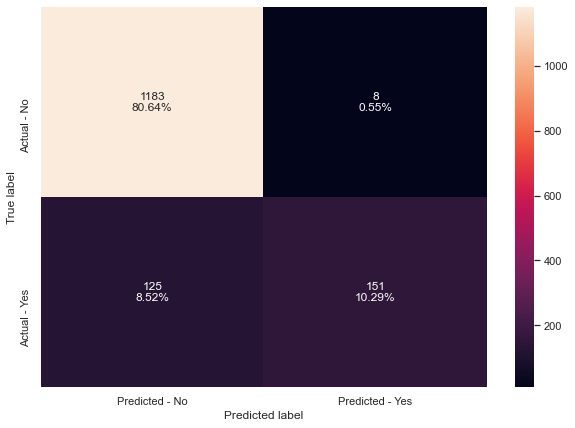

In [121]:
make_confusion_matrix(rf_wt,y_test)

In [122]:
wt_rf_acc = get_accuracy_score(rf_wt)
wt_rf_recall = get_recall_score(rf_wt)
wt_rf_precision = get_precision_score(rf_wt)
wt_rf_f1score  = get_f1_score(rf_wt)

Accuracy on training set :  1.0
Accuracy on test set :  0.9093387866394002
Recall on training set :  1.0
Recall on test set :  0.5471014492753623
Precision on training set :  1.0
Precision on test set :  0.949685534591195
f1 score on training set :  1.0
f1 score  on test set :  0.6942528735632183


* There is not much improvement in metrics of weighted random forest as compared to the unweighted random forest.

### Performance improvement for bagging :  Tuning Models -  Using GridSearch for Hyperparameter tuning model

* Although both Recall and precision should be good so we should have good values for recall and precision. For this model, higher recall will save cost and higher precision will increase the customers who will buy the package.

**Tuning Decision Tree**

In [123]:
## choose the type of classifier
dtree_estimator = DecisionTreeClassifier(class_weight={0:0.17,1:0.83},random_state=1)
#grid of parameters to choose from
parameters={
        'max_depth':np.arange(2,30),
        'min_samples_leaf':[1,2,5,7,10],
        'max_leaf_nodes':[2,3,5,10,15],
        'min_impurity_decrease':[0.0001,0.001,0.01,0.1]
        }
scorer = metrics.make_scorer(metrics.recall_score)
#run grid search
grid_obj=GridSearchCV(dtree_estimator, parameters, scoring=scorer)
grid_obj=grid_obj.fit(X_train,y_train)
# Set the clf to the best combination of parameters
dtree_estimator = grid_obj.best_estimator_

# Fit the best algorithm to the data. 
dtree_estimator.fit(X_train, y_train)


DecisionTreeClassifier(class_weight={0: 0.17, 1: 0.83}, max_depth=2,
                       max_leaf_nodes=2, min_impurity_decrease=0.1,
                       random_state=1)

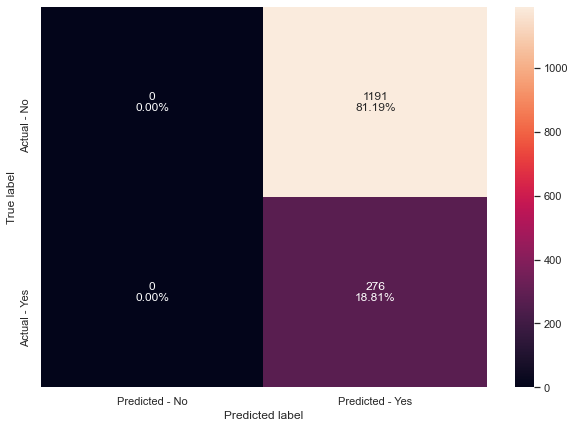

In [124]:
make_confusion_matrix(dtree_estimator,y_test)

In [125]:
tuned_dtree_acc = get_accuracy_score(dtree_estimator)
tuned_dtree_recall = get_recall_score(dtree_estimator)
tuned_dtree_precision = get_precision_score(dtree_estimator)
tuned_dtree_f1score  = get_f1_score(dtree_estimator)

Accuracy on training set :  0.1882490499853844
Accuracy on test set :  0.18813905930470348
Recall on training set :  1.0
Recall on test set :  1.0
Precision on training set :  0.1882490499853844
Precision on test set :  0.18813905930470348
f1 score on training set :  0.3168511685116851
f1 score  on test set :  0.31669535283993117


* Tunned decision tree is not performing well.

**Tuning Bagging Classifier**

In [126]:
# grid search for bagging classifier
cl1 = DecisionTreeClassifier(class_weight={0:0.13,1:0.87},random_state=1)
param_grid = {'base_estimator':[cl1],
              'n_estimators':[5,7,15,51,101],
              'max_features': [0.7,0.8,0.9,1.0]
             }

grid = GridSearchCV(BaggingClassifier(random_state=1,bootstrap=True), param_grid=param_grid, scoring = 'recall', cv = 5)
grid.fit(X_train, y_train)

GridSearchCV(cv=5, estimator=BaggingClassifier(random_state=1),
             param_grid={'base_estimator': [DecisionTreeClassifier(class_weight={0: 0.13,
                                                                                 1: 0.87},
                                                                   random_state=1)],
                         'max_features': [0.7, 0.8, 0.9, 1.0],
                         'n_estimators': [5, 7, 15, 51, 101]},
             scoring='recall')

In [127]:
## getting the best estimator
bagging_estimator  = grid.best_estimator_
bagging_estimator.fit(X_train,y_train)

BaggingClassifier(base_estimator=DecisionTreeClassifier(class_weight={0: 0.13,
                                                                      1: 0.87},
                                                        random_state=1),
                  n_estimators=5, random_state=1)

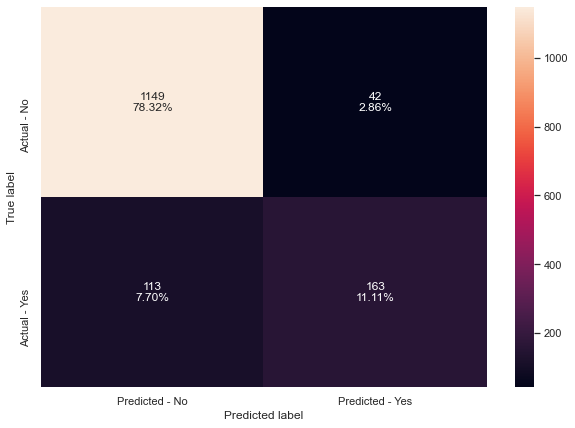

In [128]:
make_confusion_matrix(bagging_estimator,y_test)

In [129]:
tuned_bagging_acc= get_accuracy_score(bagging_estimator)
tuned_bagging_recall = get_recall_score(bagging_estimator)
tuned_bagging_precision = get_precision_score(bagging_estimator)
tuned_bagging_f1score  = get_f1_score(bagging_estimator)

Accuracy on training set :  0.9862613270973399
Accuracy on test set :  0.8943421949556919
Recall on training set :  0.9596273291925466
Recall on test set :  0.5905797101449275
Precision on training set :  0.9671361502347418
Precision on test set :  0.7951219512195122
f1 score on training set :  0.9633671083398285
f1 score  on test set :  0.6777546777546778


* Tunned decision tree is not performing well for recall on test data.

**Tuning Random Forest**

In [130]:
# Choose the type of classifier. 
rf_estimator = RandomForestClassifier(random_state=1)

# Grid of parameters to choose from
parameters = {  
        "n_estimators": [110,251,501],
        "min_samples_leaf": np.arange(1, 6,1),
        "max_features": [0.7,0.9,'log2','auto',1.0],
        "max_samples": [0.7,0.9,None],
}


# Run the grid search
grid_obj = GridSearchCV(rf_estimator, parameters, scoring='recall',cv=5)
grid_obj = grid_obj.fit(X_train, y_train)

# Set the clf to the best combination of parameters
rf_estimator = grid_obj.best_estimator_

# Fit the best algorithm to the data. 
rf_estimator.fit(X_train, y_train)

RandomForestClassifier(max_features=1.0, n_estimators=251, random_state=1)

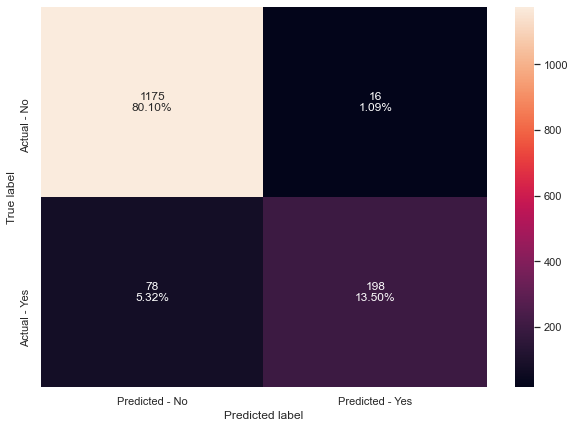

In [131]:
make_confusion_matrix(rf_estimator,y_test)

In [132]:
tuned_rf_acc = get_accuracy_score(rf_estimator)
tuned_rf_recall = get_recall_score(rf_estimator)
tuned_rf_precision = get_precision_score(rf_estimator)
tuned_rf_f1score  = get_f1_score(rf_estimator)

Accuracy on training set :  1.0
Accuracy on test set :  0.9359236537150648
Recall on training set :  1.0
Recall on test set :  0.717391304347826
Precision on training set :  1.0
Precision on test set :  0.9252336448598131
f1 score on training set :  1.0
f1 score  on test set :  0.8081632653061225


### Boosting Models

In [133]:
abc = AdaBoostClassifier(random_state=1)
abc.fit(X_train,y_train)

AdaBoostClassifier(random_state=1)

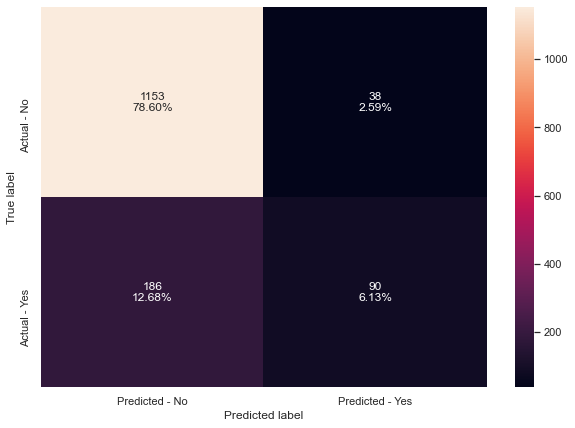

In [134]:
make_confusion_matrix(abc,y_test)

In [135]:
tuned_rf_acc = get_accuracy_score(abc)
tuned_rf_recall = get_recall_score(abc)
tuned_rf_precision = get_precision_score(abc)
tuned_rf_f1score  = get_f1_score(abc)

Accuracy on training set :  0.8485822858813212
Accuracy on test set :  0.847307430129516
Recall on training set :  0.32608695652173914
Recall on test set :  0.32608695652173914
Precision on training set :  0.7142857142857143
Precision on test set :  0.703125
f1 score on training set :  0.4477611940298507
f1 score  on test set :  0.4455445544554455


### Gradient Boosting Classifier

In [136]:
gbc = GradientBoostingClassifier(random_state=1)
gbc.fit(X_train,y_train)

GradientBoostingClassifier(random_state=1)

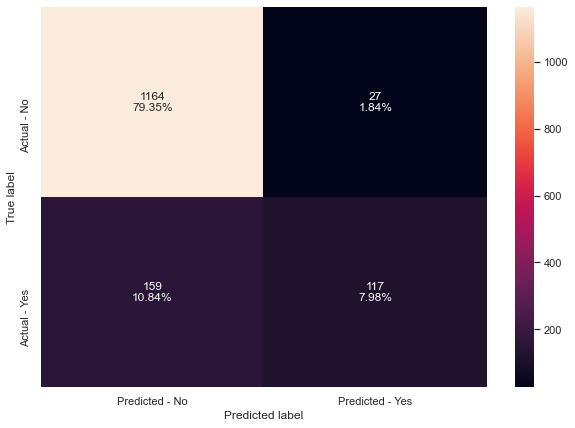

In [137]:
make_confusion_matrix(gbc,y_test)

In [138]:
tuned_rf_acc = get_accuracy_score(gbc)
tuned_rf_recall = get_recall_score(gbc)
tuned_rf_precision = get_precision_score(gbc)
tuned_rf_f1score  = get_f1_score(gbc)

Accuracy on training set :  0.8851213095586086
Accuracy on test set :  0.8732106339468303
Recall on training set :  0.4518633540372671
Recall on test set :  0.42391304347826086
Precision on training set :  0.879154078549849
Precision on test set :  0.8125
f1 score on training set :  0.5969230769230769
f1 score  on test set :  0.5571428571428573


* Recall value is very low for this model.

### XGBoost Classifier

In [139]:
xgb = XGBClassifier(random_state=1)
xgb.fit(X_train,y_train)

[15:30:16] WARNING: C:/Users/Administrator/workspace/xgboost-win64_release_1.4.0/src/learner.cc:1095: Starting in XGBoost 1.3.0, the default evaluation metric used with the objective 'binary:logistic' was changed from 'error' to 'logloss'. Explicitly set eval_metric if you'd like to restore the old behavior.


XGBClassifier(base_score=0.5, booster='gbtree', colsample_bylevel=1,
              colsample_bynode=1, colsample_bytree=1, gamma=0, gpu_id=-1,
              importance_type='gain', interaction_constraints='',
              learning_rate=0.300000012, max_delta_step=0, max_depth=6,
              min_child_weight=1, missing=nan, monotone_constraints='()',
              n_estimators=100, n_jobs=8, num_parallel_tree=1, random_state=1,
              reg_alpha=0, reg_lambda=1, scale_pos_weight=1, subsample=1,
              tree_method='exact', validate_parameters=1, verbosity=None)

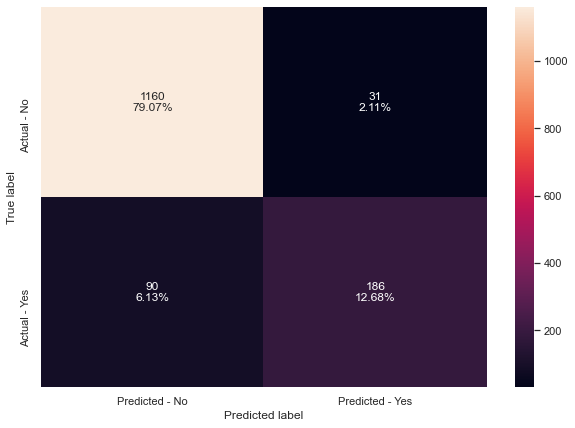

In [140]:
make_confusion_matrix(xgb,y_test)

In [141]:
tuned_rf_acc = get_accuracy_score(xgb)
tuned_rf_recall = get_recall_score(xgb)
tuned_rf_precision = get_precision_score(xgb)
tuned_rf_f1score  = get_f1_score(xgb)

Accuracy on training set :  0.9997076878105817
Accuracy on test set :  0.9175187457396047
Recall on training set :  0.9984472049689441
Recall on test set :  0.6739130434782609
Precision on training set :  1.0
Precision on test set :  0.8571428571428571
f1 score on training set :  0.9992229992229993
f1 score  on test set :  0.7545638945233266


### Model performance improvement for Boosting models: Using GridSearch for Hyperparameter tuning model

### AdaBoost Classifier

In [142]:
# Choose the type of classifier. 
abc_tuned = AdaBoostClassifier(random_state=1)

# Grid of parameters to choose from
## add from article
parameters = {
    #Let's try different max_depth for base_estimator
    "base_estimator":[DecisionTreeClassifier(max_depth=1),DecisionTreeClassifier(max_depth=2),DecisionTreeClassifier(max_depth=3)],
    "n_estimators": np.arange(10,110,10),
    "learning_rate":np.arange(0.1,2,0.1)
}

# Type of scoring used to compare parameter combinations
acc_scorer = metrics.make_scorer(metrics.recall_score)

# Run the grid search
grid_obj = GridSearchCV(abc_tuned, parameters, scoring=acc_scorer,cv=5)
grid_obj = grid_obj.fit(X_train, y_train)

# Set the clf to the best combination of parameters
abc_tuned = grid_obj.best_estimator_

# Fit the best algorithm to the data.
abc_tuned.fit(X_train, y_train)

AdaBoostClassifier(base_estimator=DecisionTreeClassifier(max_depth=3),
                   learning_rate=1.6, n_estimators=90, random_state=1)

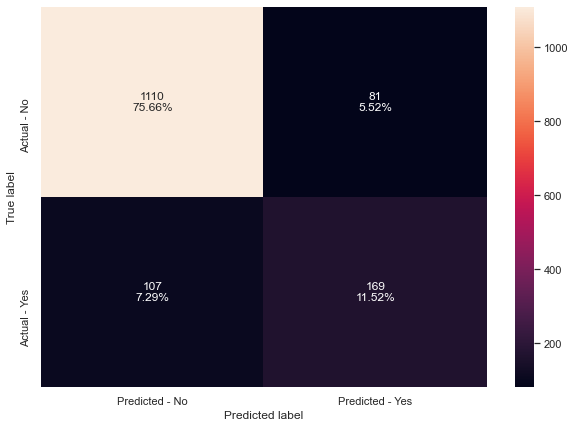

In [143]:
make_confusion_matrix(abc_tuned,y_test)

In [144]:
tuned_abc_acc = get_accuracy_score(abc_tuned)
tuned_abc_recall = get_recall_score(abc_tuned)
tuned_abc_precision = get_precision_score(abc_tuned)
tuned_abc_f1score  = get_f1_score(abc_tuned)

Accuracy on training set :  0.9801227711195557
Accuracy on test set :  0.8718473074301295
Recall on training set :  0.9332298136645962
Recall on test set :  0.6123188405797102
Precision on training set :  0.9600638977635783
Precision on test set :  0.676
f1 score on training set :  0.9464566929133857
f1 score  on test set :  0.6425855513307985


### Gradient Boosting Classifier

In [145]:
# Choose the type of classifier. 
gbc_tuned = GradientBoostingClassifier(init=AdaBoostClassifier(random_state=1),random_state=1)

# Grid of parameters to choose from
## add from article
parameters = {
    "n_estimators": [100,150,200,250],
    "subsample":[0.8,0.9,1],
    "max_features":[0.7,0.8,0.9,1]
}

# Type of scoring used to compare parameter combinations
acc_scorer = metrics.make_scorer(metrics.recall_score)

# Run the grid search
grid_obj = GridSearchCV(gbc_tuned, parameters, scoring=acc_scorer,cv=5)
grid_obj = grid_obj.fit(X_train, y_train)

# Set the clf to the best combination of parameters
gbc_tuned = grid_obj.best_estimator_

# Fit the best algorithm to the data.
gbc_tuned.fit(X_train, y_train)

GradientBoostingClassifier(init=AdaBoostClassifier(random_state=1),
                           max_features=0.8, n_estimators=250, random_state=1,
                           subsample=0.8)

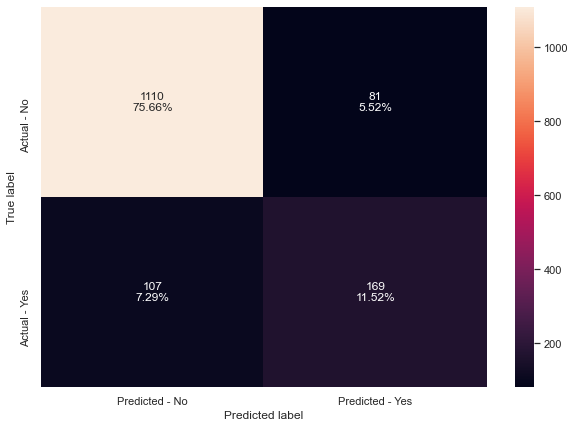

In [146]:
make_confusion_matrix(abc_tuned,y_test)

In [147]:
tuned_abc_acc = get_accuracy_score(abc_tuned)
tuned_abc_recall = get_recall_score(abc_tuned)
tuned_abc_precision = get_precision_score(abc_tuned)
tuned_abc_f1score  = get_f1_score(abc_tuned)

Accuracy on training set :  0.9801227711195557
Accuracy on test set :  0.8718473074301295
Recall on training set :  0.9332298136645962
Recall on test set :  0.6123188405797102
Precision on training set :  0.9600638977635783
Precision on test set :  0.676
f1 score on training set :  0.9464566929133857
f1 score  on test set :  0.6425855513307985


### XGBoost Classifier

In [148]:
# Choose the type of classifier. 
xgb_tuned = XGBClassifier(random_state=1)

# Grid of parameters to choose from
## add from
parameters = {
    "n_estimators": np.arange(10,100,20),
    "scale_pos_weight":[0,1,2,5],
    "subsample":[0.5,0.7,0.9,1],
    "learning_rate":[0.01,0.1,0.2,0.05],
    "gamma":[0,1,3],
    "colsample_bytree":[0.5,0.7,0.9,1],
    "colsample_bylevel":[0.5,0.7,0.9,1]
}

# Type of scoring used to compare parameter combinations
acc_scorer = metrics.make_scorer(metrics.recall_score)

# Run the grid search
grid_obj = GridSearchCV(xgb_tuned, parameters,scoring=acc_scorer,cv=5)
grid_obj = grid_obj.fit(X_train, y_train)

# Set the clf to the best combination of parameters
xgb_tuned = grid_obj.best_estimator_

# Fit the best algorithm to the data.
xgb_tuned.fit(X_train, y_train)

[15:49:04] WARNING: C:/Users/Administrator/workspace/xgboost-win64_release_1.4.0/src/learner.cc:1095: Starting in XGBoost 1.3.0, the default evaluation metric used with the objective 'binary:logistic' was changed from 'error' to 'logloss'. Explicitly set eval_metric if you'd like to restore the old behavior.
[15:49:04] WARNING: C:/Users/Administrator/workspace/xgboost-win64_release_1.4.0/src/learner.cc:1095: Starting in XGBoost 1.3.0, the default evaluation metric used with the objective 'binary:logistic' was changed from 'error' to 'logloss'. Explicitly set eval_metric if you'd like to restore the old behavior.
[15:49:04] WARNING: C:/Users/Administrator/workspace/xgboost-win64_release_1.4.0/src/learner.cc:1095: Starting in XGBoost 1.3.0, the default evaluation metric used with the objective 'binary:logistic' was changed from 'error' to 'logloss'. Explicitly set eval_metric if you'd like to restore the old behavior.
[15:49:04] WARNING: C:/Users/Administrator/workspace/xgboost-win64_rel

XGBClassifier(base_score=0.5, booster='gbtree', colsample_bylevel=0.5,
              colsample_bynode=1, colsample_bytree=0.7, gamma=3, gpu_id=-1,
              importance_type='gain', interaction_constraints='',
              learning_rate=0.1, max_delta_step=0, max_depth=6,
              min_child_weight=1, missing=nan, monotone_constraints='()',
              n_estimators=50, n_jobs=8, num_parallel_tree=1, random_state=1,
              reg_alpha=0, reg_lambda=1, scale_pos_weight=5, subsample=1,
              tree_method='exact', validate_parameters=1, verbosity=None)

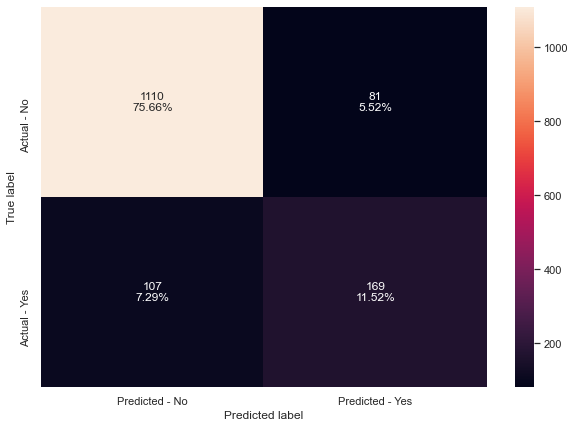

In [149]:
make_confusion_matrix(abc_tuned,y_test)

In [150]:
tuned_abc_acc = get_accuracy_score(abc_tuned)
tuned_abc_recall = get_recall_score(abc_tuned)
tuned_abc_precision = get_precision_score(abc_tuned)
tuned_abc_f1score  = get_f1_score(abc_tuned)

Accuracy on training set :  0.9801227711195557
Accuracy on test set :  0.8718473074301295
Recall on training set :  0.9332298136645962
Recall on test set :  0.6123188405797102
Precision on training set :  0.9600638977635783
Precision on test set :  0.676
f1 score on training set :  0.9464566929133857
f1 score  on test set :  0.6425855513307985


### Feature importance of XGB model

In [155]:
# importance of features in the tree building ( The importance of a feature is computed as the 
#(normalized) total reduction of the criterion brought by that feature. It is also known as the Gini importance )

print(pd.DataFrame(xgb_tuned.feature_importances_, columns = ["Imp"], index = X_train.columns).sort_values(by = 'Imp', ascending = False))

                                  Imp
Passport                     0.125633
Designation_Executive        0.099292
MaritalStatus_Single         0.061920
CityTier                     0.045879
ProductPitched_Deluxe        0.042204
ProductPitched_Standard      0.039795
Designation_Senior Manager   0.037438
MaritalStatus_Unmarried      0.037071
PreferredPropertyStar        0.033608
Age_scaled                   0.031642
MaritalStatus_Married        0.031309
Designation_Manager          0.031247
ProductPitched_Super Deluxe  0.031194
MonthlyIncome_scaled         0.029398
PitchSatisfactionScore       0.029118
DurationOfPitch              0.028167
NumberOfFollowups            0.026702
Designation_VP               0.026596
NumberOfTrips                0.025936
Occupation_Large Business    0.025737
TypeofContact_Self Enquiry   0.024087
Gender_Male                  0.024083
Occupation_Salaried          0.023235
OwnCar                       0.021691
Occupation_Small Business    0.020016
ProductPitch

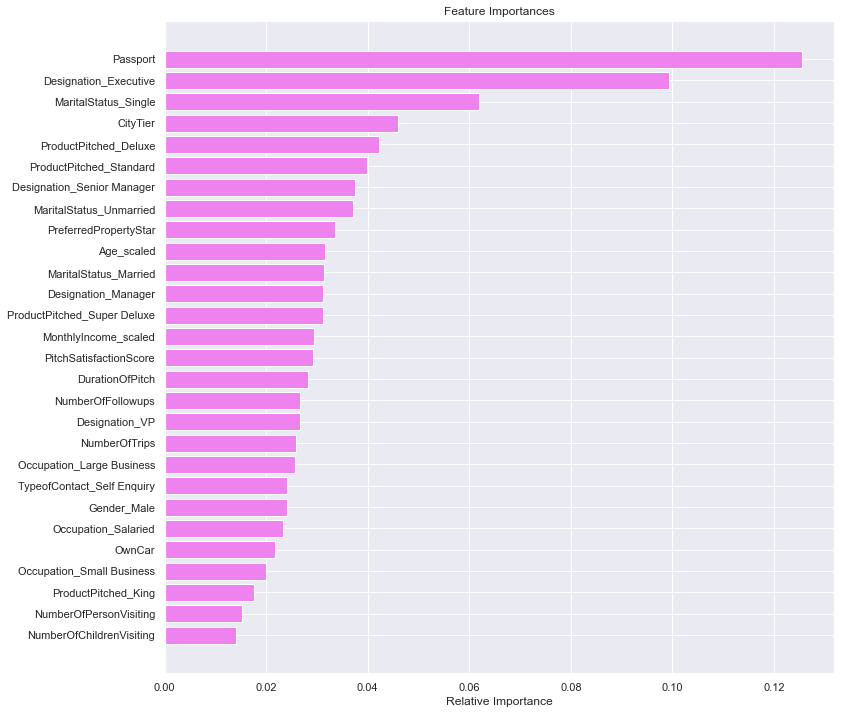

In [156]:
feature_names = X_train.columns
importances = xgb_tuned.feature_importances_
indices = np.argsort(importances)

plt.figure(figsize=(12,12))
plt.title('Feature Importances')
plt.barh(range(len(indices)), importances[indices], color='violet', align='center')
plt.yticks(range(len(indices)), [feature_names[i] for i in indices])
plt.xlabel('Relative Importance')
plt.show()

### Stacking model

** Now, let's build a stacking model with the tuned models - decision tree, random forest and gradient boosting, then use XGBoost to get the final prediction.**

In [158]:
estimators=[('Decision Tree', dtree_estimator),('Random Forest', rf_estimator),
           ('Gradient Boosting', gbc_tuned)]
final_estimator=XGBClassifier(random_state=1)


In [161]:
stacking_estimator=StackingClassifier(estimators=estimators, final_estimator=final_estimator,cv=5)
stacking_estimator.fit(X_train,y_train)

[22:26:47] WARNING: C:/Users/Administrator/workspace/xgboost-win64_release_1.4.0/src/learner.cc:1095: Starting in XGBoost 1.3.0, the default evaluation metric used with the objective 'binary:logistic' was changed from 'error' to 'logloss'. Explicitly set eval_metric if you'd like to restore the old behavior.


StackingClassifier(cv=5,
                   estimators=[('Decision Tree',
                                DecisionTreeClassifier(class_weight={0: 0.17,
                                                                     1: 0.83},
                                                       max_depth=2,
                                                       max_leaf_nodes=2,
                                                       min_impurity_decrease=0.1,
                                                       random_state=1)),
                               ('Random Forest',
                                RandomForestClassifier(max_features=1.0,
                                                       n_estimators=251,
                                                       random_state=1)),
                               ('Gradient Boosting',
                                GradientBoostingClassifier(init=AdaBoostClassifier(random_state=...
                                                 imp

In [162]:
tuned_abc_acc = get_accuracy_score(abc_tuned)
tuned_abc_recall = get_recall_score(abc_tuned)
tuned_abc_precision = get_precision_score(abc_tuned)
tuned_abc_f1score  = get_f1_score(abc_tuned)

Accuracy on training set :  0.9801227711195557
Accuracy on test set :  0.8718473074301295
Recall on training set :  0.9332298136645962
Recall on test set :  0.6123188405797102
Precision on training set :  0.9600638977635783
Precision on test set :  0.676
f1 score on training set :  0.9464566929133857
f1 score  on test set :  0.6425855513307985


### Comparing all the models - Model performance evaluation

In [165]:
# defining list of models
models = [dtree,dtree_estimator,bagging,bagging_wt,bagging_estimator,rf,rf_wt,rf_estimator,abc,gbc,xgb,abc_tuned,gbc_tuned,xgb_tuned,stacking_estimator]
# defining empty lists to add train and test results
acc_train = []
acc_test = []
recall_train = []
recall_test = []
precision_train = []
precision_test = []
f1_score_train=[]
f1_score_test=[]

# looping through all the models to get the accuracy,recall and precision scores
for model in models:
    # accuracy score
    j = get_accuracy_score(model,False)
    acc_train.append(j[0])
    acc_test.append(j[1])
    # recall score
    k = get_recall_score(model,False)
    recall_train.append(k[0])
    recall_test.append(k[1])
    # precision score
    l = get_precision_score(model,False)
    precision_train.append(l[0])
    precision_test.append(l[1])
    # f1 score
    m = get_f1_score(model,False)
    f1_score_train.append(m[0])
    f1_score_test.append(m[1])

In [166]:
comparison_frame = pd.DataFrame({'Model':['Decision Tree','Tuned Decision Tree','Bagging Classifier',
                                          'Weighted Bagging Classifier','Tuned Bagging Classifier',
                                          'Random Forest','Weighted Random Forest','Tuned Random Forest','Ada Boosting',
                                          'Gredient Boosting','XGB','Tunned Ada Boost','Tunned Gradient Boosting',
                                          'Tunned XGB','Stacked Model'], 
                                          'Train_Accuracy': acc_train,
                                          'Test_Accuracy': acc_test,
                                          'Train_Recall': recall_train,
                                          'Test_Recall': recall_test,
                                          'Train_Precision': precision_train,
                                          'Test_Precision': precision_test,
                                          'Train_f1score': f1_score_train,
                                          'Test_f1score': f1_score_test}) 
comparison_frame

,Model,Train_Accuracy,Test_Accuracy,Train_Recall,Test_Recall,Train_Precision,Test_Precision,Train_f1score,Test_f1score
0,Decision Tree,1.000000,0.890252,1.000000,0.699275,1.000000,0.712177,1.000000,0.705667
1,Tuned Decision Tree,0.188249,0.188139,1.000000,1.000000,0.188249,0.188139,0.316851,0.316695
2,Bagging Classifier,0.994154,0.908657,0.970497,0.615942,0.998403,0.858586,0.984252,0.717300
3,Weighted Bagging Classifier,0.991815,0.907294,0.959627,0.576087,0.996774,0.893258,0.977848,0.700441
4,Tuned Bagging Classifier,0.986261,0.894342,0.959627,0.590580,0.967136,0.795122,0.963367,0.677755
5,Random Forest,1.000000,0.910702,1.000000,0.565217,1.000000,0.934132,1.000000,0.704289
6,Weighted Random Forest,1.000000,0.909339,1.000000,0.547101,1.000000,0.949686,1.000000,0.694253
7,Tuned Random Forest,1.000000,0.935924,1.000000,0.717391,1.000000,0.925234,1.000000,0.808163
8,Ada Boosting,0.848582,0.847307,0.326087,0.326087,0.714286,0.703125,0.447761,0.445545
9,Gredient Boosting,0.885121,0.873211,0.451863,0.423913,0.879154,0.812500,0.596923,0.557143


#### Best Model: 
** After comparing these models, Tunned XGB model turned out to be the best model. First it has good recall metrics for both train and test data. 
** Also difference between all of the metrics for train and test data is minimum among all of the model. 
** Final model performanceee can be improved by changing different hyper parameters.

### Feature importance of Best  model- XGB tunned 

In [167]:
# importance of features in the tree building ( The importance of a feature is computed as the 
#(normalized) total reduction of the criterion brought by that feature. It is also known as the Gini importance )

print(pd.DataFrame(xgb_tuned.feature_importances_, columns = ["Imp"], index = X_train.columns).sort_values(by = 'Imp', ascending = False))

                                  Imp
Passport                     0.125633
Designation_Executive        0.099292
MaritalStatus_Single         0.061920
CityTier                     0.045879
ProductPitched_Deluxe        0.042204
ProductPitched_Standard      0.039795
Designation_Senior Manager   0.037438
MaritalStatus_Unmarried      0.037071
PreferredPropertyStar        0.033608
Age_scaled                   0.031642
MaritalStatus_Married        0.031309
Designation_Manager          0.031247
ProductPitched_Super Deluxe  0.031194
MonthlyIncome_scaled         0.029398
PitchSatisfactionScore       0.029118
DurationOfPitch              0.028167
NumberOfFollowups            0.026702
Designation_VP               0.026596
NumberOfTrips                0.025936
Occupation_Large Business    0.025737
TypeofContact_Self Enquiry   0.024087
Gender_Male                  0.024083
Occupation_Salaried          0.023235
OwnCar                       0.021691
Occupation_Small Business    0.020016
ProductPitch

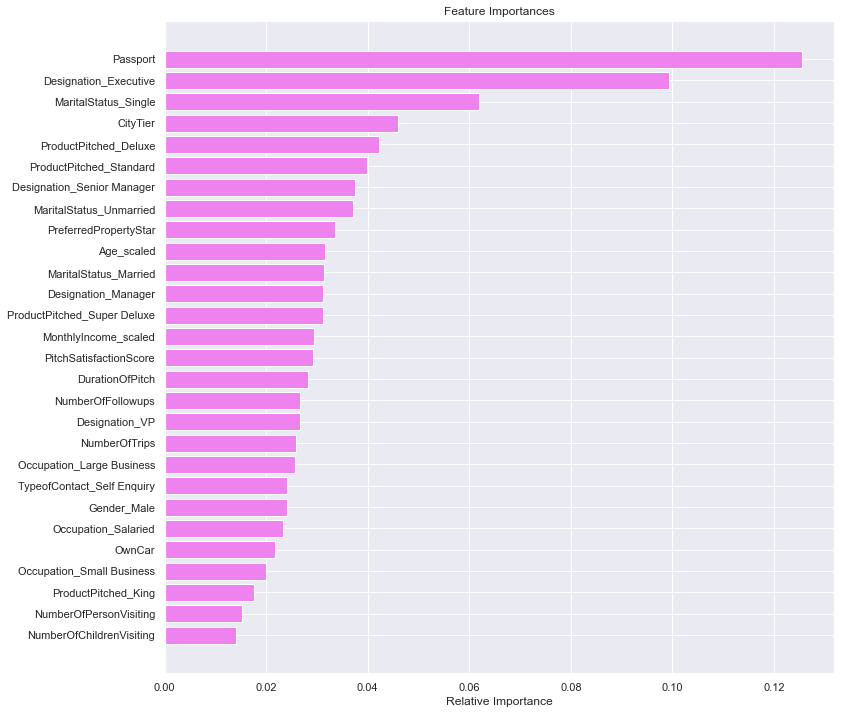

In [168]:
feature_names = X_train.columns
importances = xgb_tuned.feature_importances_
indices = np.argsort(importances)

plt.figure(figsize=(12,12))
plt.title('Feature Importances')
plt.barh(range(len(indices)), importances[indices], color='violet', align='center')
plt.yticks(range(len(indices)), [feature_names[i] for i in indices])
plt.xlabel('Relative Importance')
plt.show()

* `Passport` has highest importance. More customer having passport are more likely to take product so his is major factor to offere product to those customer.
* `Designation` has second highes importance .Specially customer who have executive designation are more likely to take these product if offered. 
* `Marital Status` has third highest importance specially single customer are more likely to take these product if offered.
* `City Tier` has next hightest importance .So cutomer from city tier 2 and 3 are mroe liekly to take these products if offered.
* `Product pitched` has next high importance.
* `Age` and `monthly incom`e hve equal importance which make sense.



### Actionable insights and  Recommendation for business

*  Company should offer packages to customer having passport as they  are more likely to take product.
*  Company should offfer package to Customer who have executive designation.
*  Company should offer package to Single or unmarried customers.
*  Company should offer to Cutomers from city tier 2 and 3.
*  Basic and standard packages are highly bought product.
* Customer preffered 3 or 5 star hotel.
* Company should offer to Cutomers Customer who have family members 2 ,3 or 4  except themself.



